In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# Introduction to Generative Adversarial Networks (GANs)

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture.

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN.



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [2]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                 transforms.Normalize((.5), (.5))]) # normalize between [-1, 1] with tanh activation

mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)

In [69]:
dataloader = DataLoader(dataset=mnist_train,
                         batch_size=batch_size,
                         shuffle=True)

In [70]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

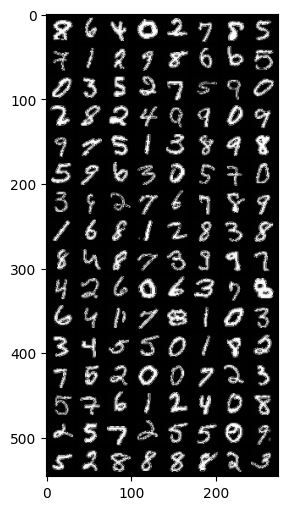

In [71]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm
- ReLU

In [3]:
def get_upscaling_block(channels_in, channels_out, kernel, stride, padding, last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU,
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
        return nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding), nn.Tanh()
    else:
        return nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding), nn.BatchNorm2d(channels_out), nn.ReLU()

class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()
        self.model = nn.Sequential(
            *get_upscaling_block(nz, ngf * 4, (4, 4), 1, 0), 
            *get_upscaling_block(ngf * 4, ngf * 2, (4, 4), 2, 1),
            *get_upscaling_block(ngf * 2, ngf, (4, 4), 2, 1),
            *get_upscaling_block(ngf, nchannels, (4, 4), 2, 1, True)            
        )


    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        return self.model(x)


### 2.1.3. Sanity Tests

In [4]:
nz = 1000
z = torch.randn(batch_size, nz)

In [5]:
G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

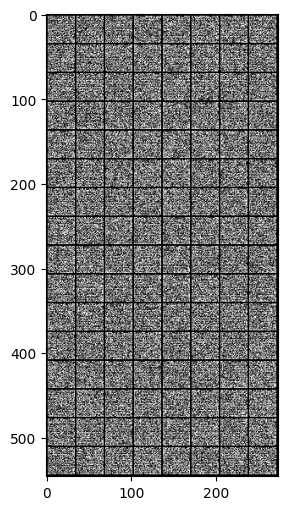

In [75]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator.

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]`

In [4]:
def get_downscaling_block(channels_in, channels_out, kernel, stride, padding, use_batch_norm=True, is_last=False):

    if is_last:
        return nn.Conv2d(channels_in, channels_out, kernel, stride, padding), nn.Sigmoid()

    elif not use_batch_norm:
        return nn.Conv2d(channels_in, channels_out, kernel, stride, padding), nn.LeakyReLU(0.2)

    else:
        return nn.Conv2d(channels_in, channels_out, kernel, stride, padding), nn.BatchNorm2d(channels_out), nn.LeakyReLU(0.2)




class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1):
        super().__init__()

        self.model = nn.Sequential(
            *get_downscaling_block(nchannels, ndf, 4, 2, 1, use_batch_norm=False),
            *get_downscaling_block(ndf, ndf*2, 4, 2, 1),
            *get_downscaling_block(ndf*2, ndf*4, 4, 2, 1),
            *get_downscaling_block(ndf*4, 1, 4, 1, 0, use_batch_norm=False, is_last=True)
        )


    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [77]:
real_batch, real_labels = next(iter(dataloader))

In [78]:
D = Discriminator(ndf=32, nchannels=1)
assert D(real_batch).shape == (real_batch.shape[0], 1)

# 3. Training

## 3.1 Loss
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [5]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions.
1. First, we need to continuously sample z from a Gaussian distribution.
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s.

In [6]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1)
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [81]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))


## 3.3 Training!

Now for the fun part, training!
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve.
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

it: 0; g_loss: 1.582372784614563; d_loss: 0.8074641227722168; avg_real_score: 0.4587339758872986; avg_fake_score: 0.5513513088226318: : 0it [00:00, ?it/s]

generated images


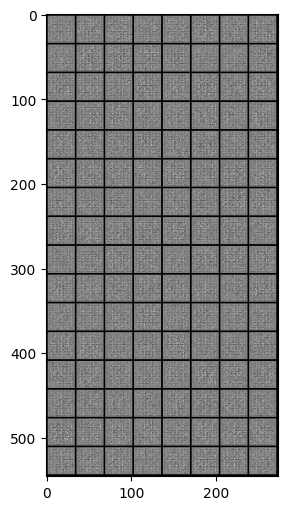

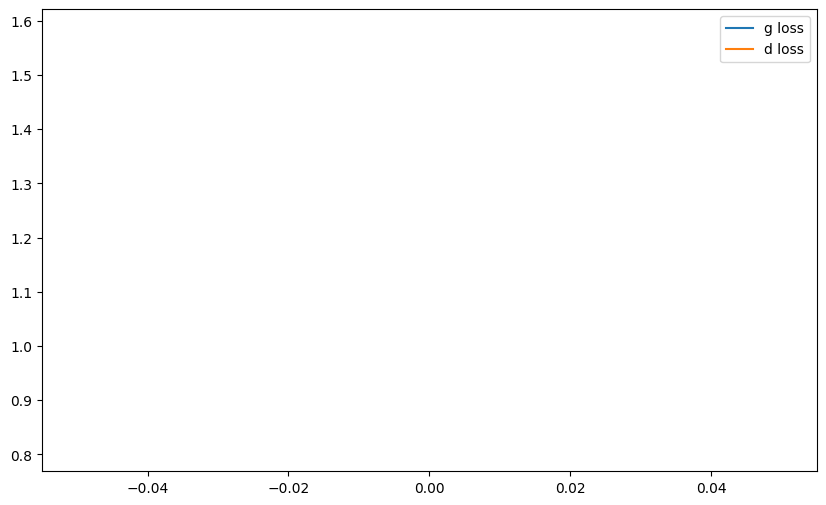

it: 200; g_loss: 1.354992151260376; d_loss: 0.4606620669364929; avg_real_score: 0.6518231630325317; avg_fake_score: 0.3689924478530884: : 200it [00:27,  6.73it/s]    

generated images


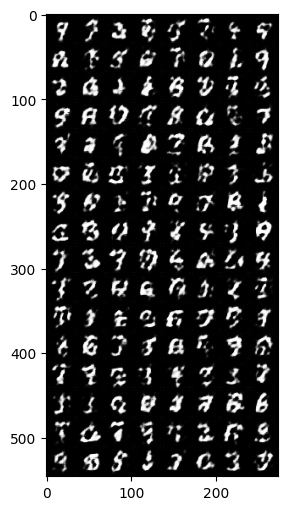

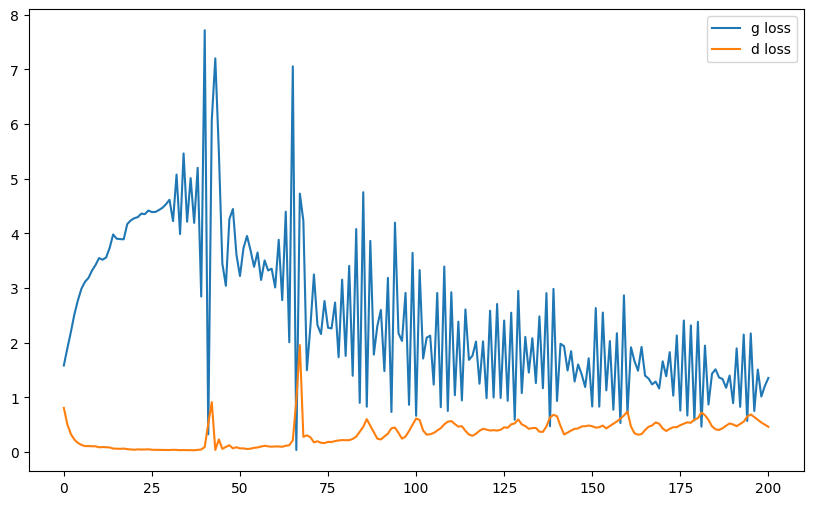

it: 400; g_loss: 1.623903751373291; d_loss: 0.597984790802002; avg_real_score: 0.7366530895233154; avg_fake_score: 0.5731163024902344: : 400it [00:59,  6.37it/s]    

generated images


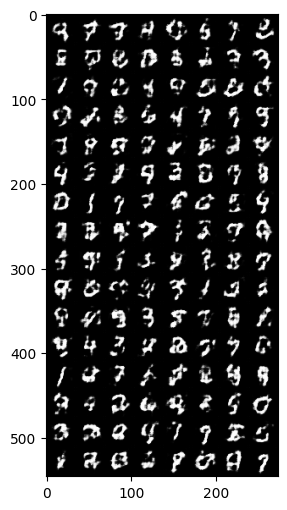

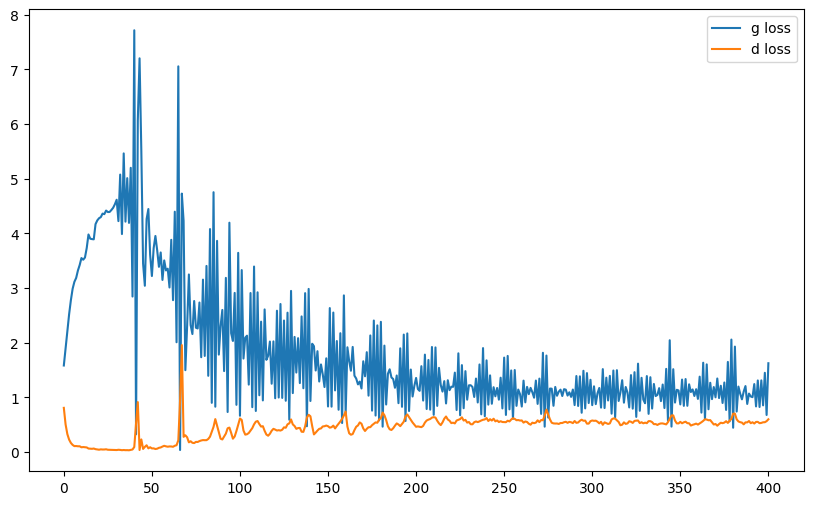

it: 468; g_loss: 0.585832417011261; d_loss: 0.6369065046310425; avg_real_score: 0.3884231448173523; avg_fake_score: 0.2502483129501343: : 469it [01:10,  6.67it/s]   
it: 469; g_loss: 1.5398101806640625; d_loss: 0.621150016784668; avg_real_score: 0.7452297210693359; avg_fake_score: 0.5978658199310303: : 0it [00:00, ?it/s]

generated images


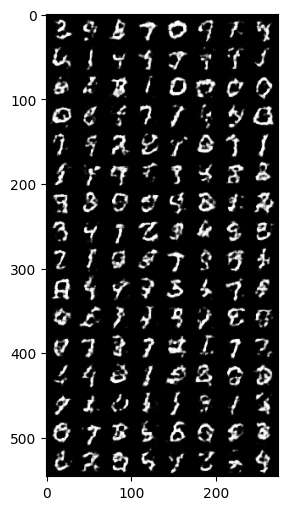

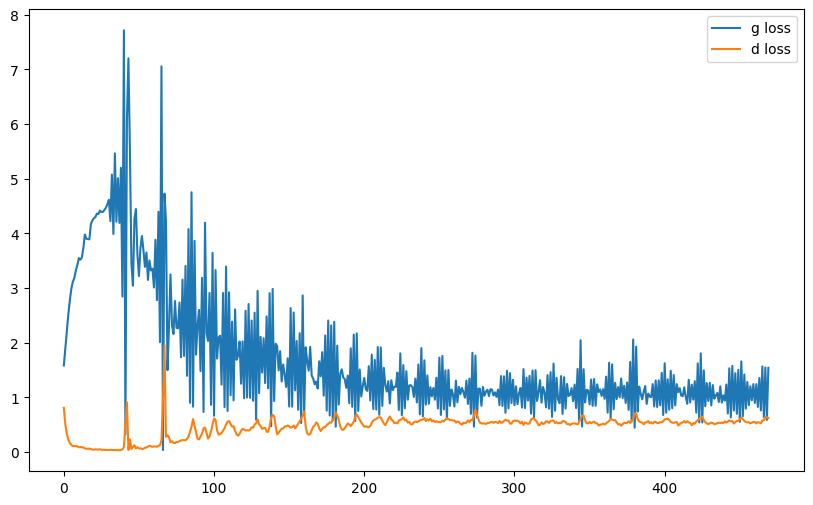

it: 669; g_loss: 0.7941592931747437; d_loss: 0.5789563059806824; avg_real_score: 0.48104777932167053; avg_fake_score: 0.3251349925994873: : 200it [00:31,  6.27it/s] 

generated images


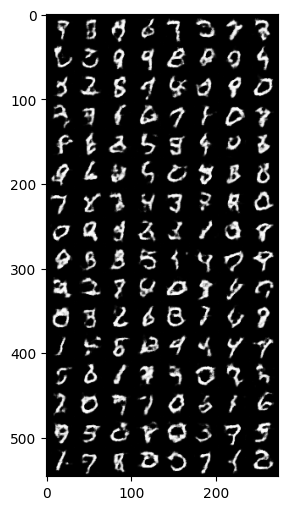

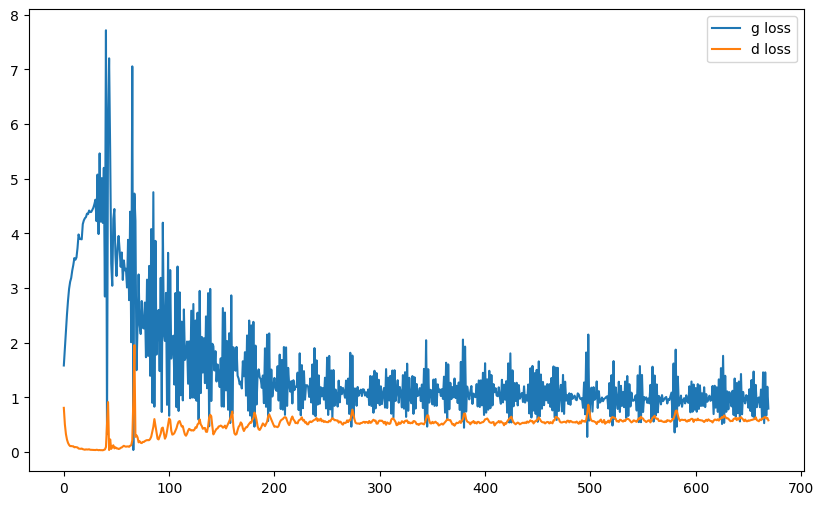

it: 869; g_loss: 1.6878641843795776; d_loss: 0.6316412091255188; avg_real_score: 0.7665271759033203; avg_fake_score: 0.6181591749191284: : 400it [01:03,  6.27it/s]  

generated images


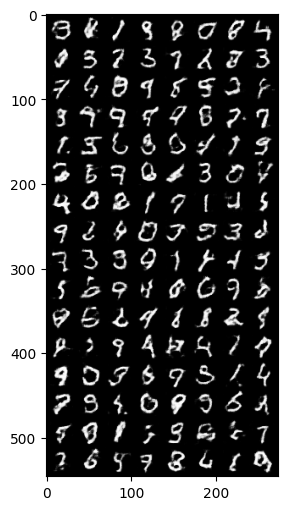

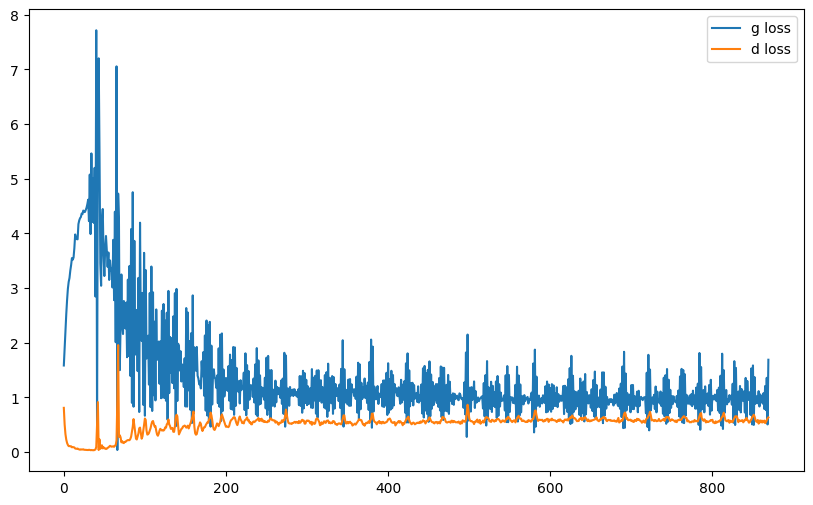

it: 937; g_loss: 0.9823467135429382; d_loss: 0.5638436079025269; avg_real_score: 0.5827857851982117; avg_fake_score: 0.42854806780815125: : 469it [01:14,  6.29it/s]  
it: 938; g_loss: 1.0449905395507812; d_loss: 0.5442206859588623; avg_real_score: 0.5980294346809387; avg_fake_score: 0.42200934886932373: : 0it [00:00, ?it/s]

generated images


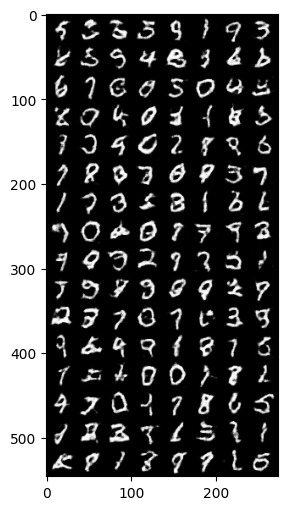

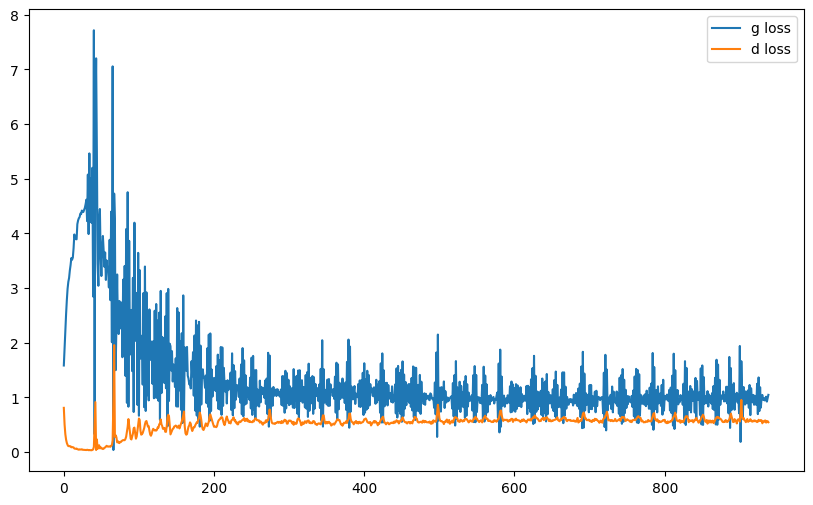

it: 1138; g_loss: 0.9586229920387268; d_loss: 0.5299785137176514; avg_real_score: 0.5873936414718628; avg_fake_score: 0.3943638801574707: : 200it [00:31,  6.41it/s]  

generated images


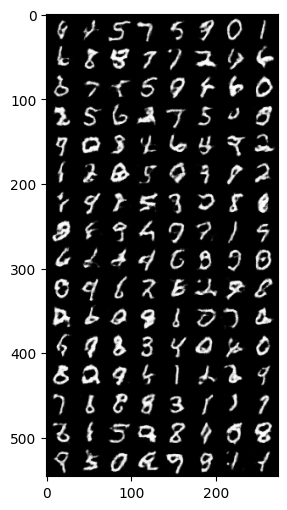

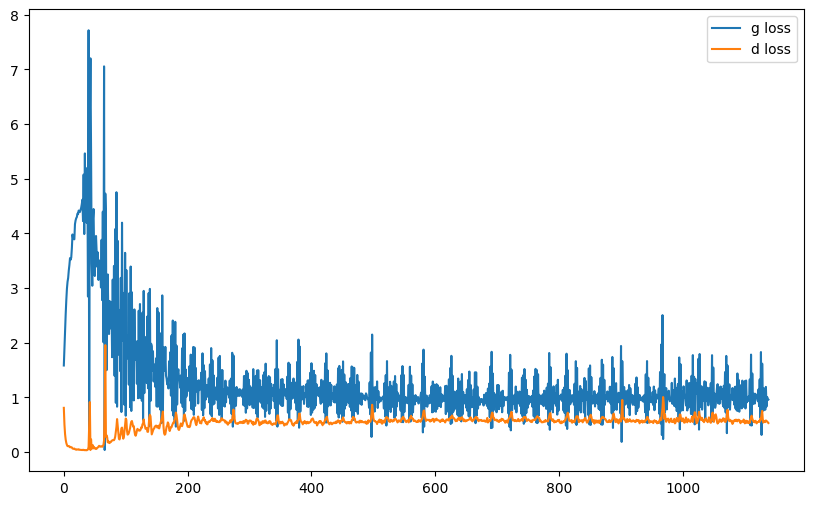

it: 1338; g_loss: 1.5275566577911377; d_loss: 0.5778137445449829; avg_real_score: 0.7268720865249634; avg_fake_score: 0.556090772151947: : 400it [01:03,  5.97it/s]    

generated images


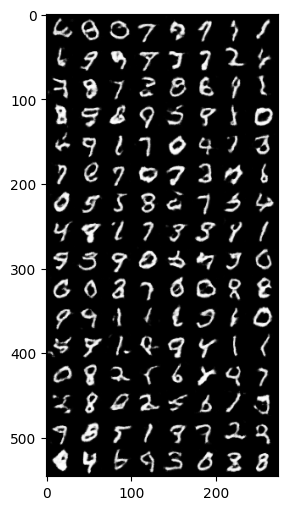

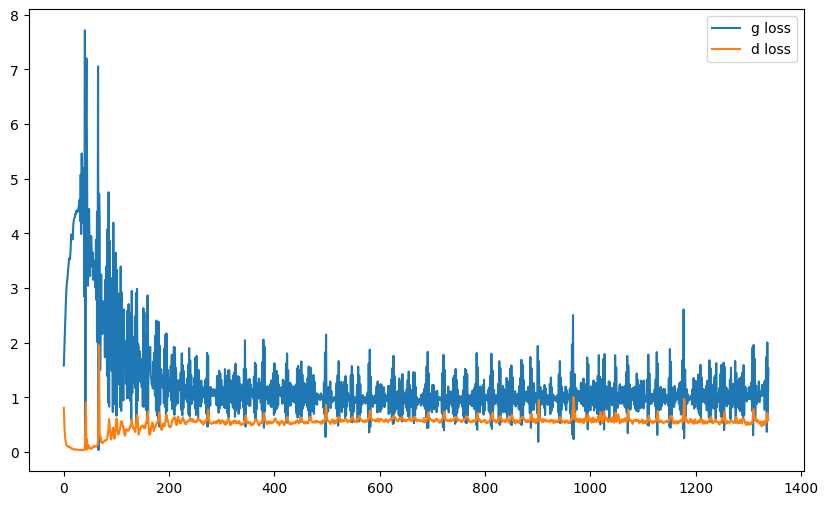

it: 1406; g_loss: 0.7025625705718994; d_loss: 0.6233338117599487; avg_real_score: 0.5086929798126221; avg_fake_score: 0.4119713306427002: : 469it [01:14,  6.29it/s]  
it: 1407; g_loss: 1.0675550699234009; d_loss: 0.6279923915863037; avg_real_score: 0.645383358001709; avg_fake_score: 0.5420293807983398: : 0it [00:00, ?it/s]

generated images


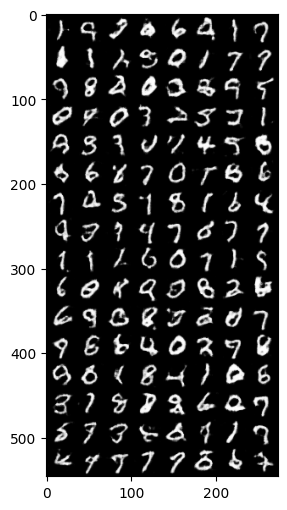

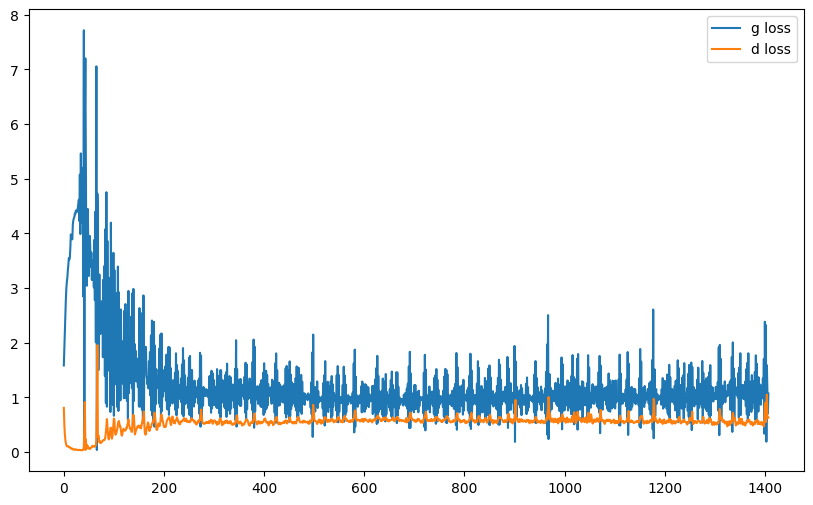

it: 1607; g_loss: 1.5328865051269531; d_loss: 0.4797416031360626; avg_real_score: 0.7583670616149902; avg_fake_score: 0.4789850115776062: : 200it [00:29,  6.51it/s]  

generated images


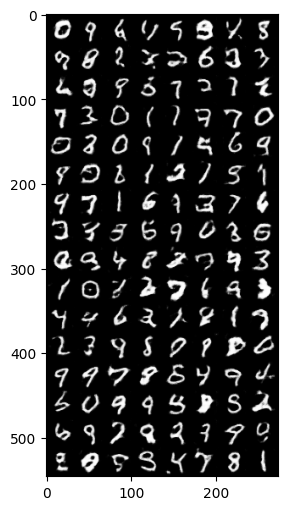

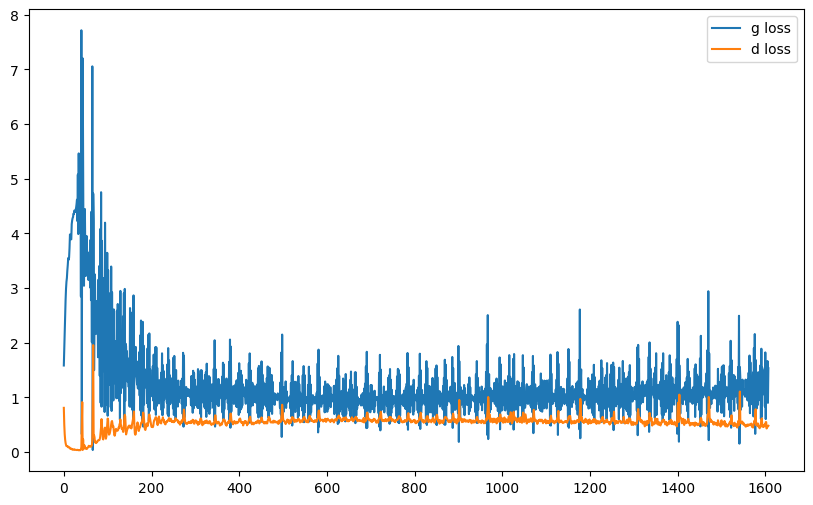

it: 1807; g_loss: 0.9717233180999756; d_loss: 0.555078387260437; avg_real_score: 0.42173561453819275; avg_fake_score: 0.1744469404220581: : 400it [00:54, 12.10it/s]   

generated images


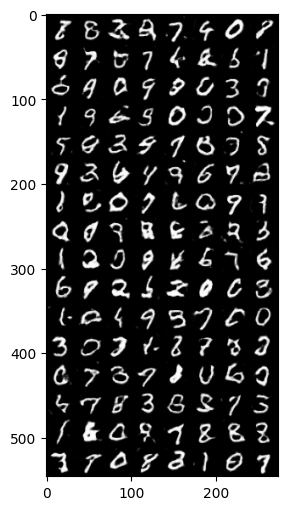

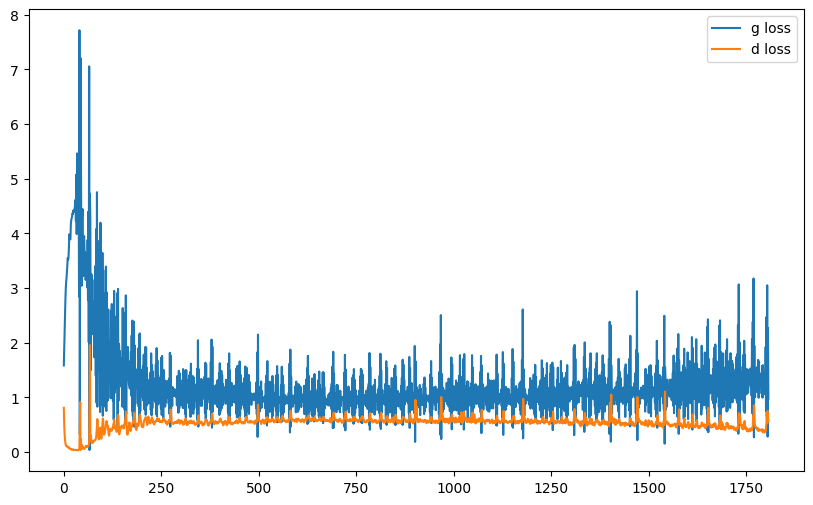

it: 1875; g_loss: 1.193267822265625; d_loss: 0.4358197748661041; avg_real_score: 0.5745812058448792; avg_fake_score: 0.2515660226345062: : 469it [01:03,  7.34it/s]   
it: 1876; g_loss: 2.9412169456481934; d_loss: 0.378110408782959; avg_real_score: 0.8610687851905823; avg_fake_score: 0.44126826524734497: : 0it [00:00, ?it/s]

generated images


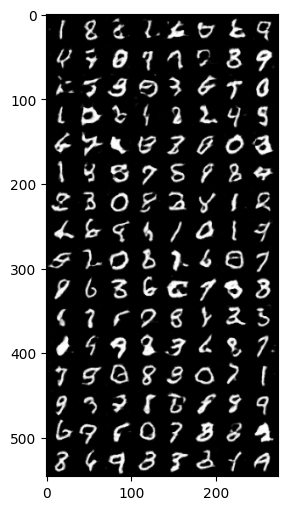

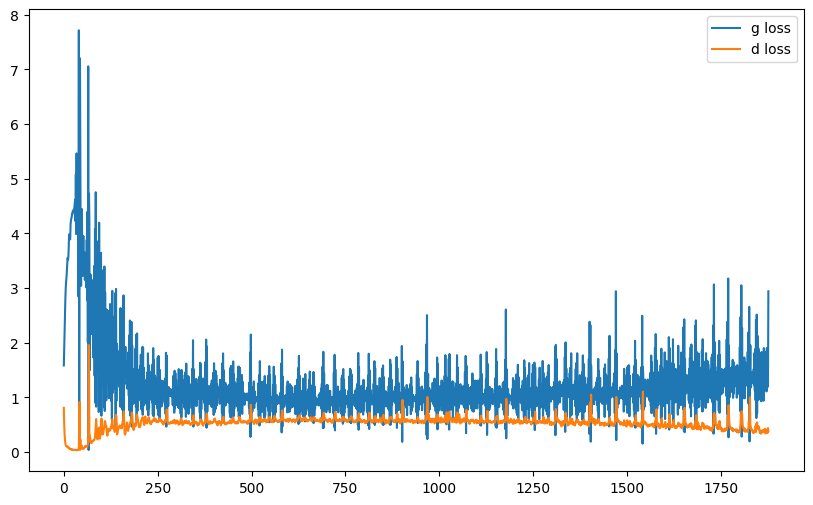

it: 2076; g_loss: 2.272374153137207; d_loss: 0.770919919013977; avg_real_score: 0.9427405595779419; avg_fake_score: 0.7569822669029236: : 200it [00:26,  9.24it/s]     

generated images


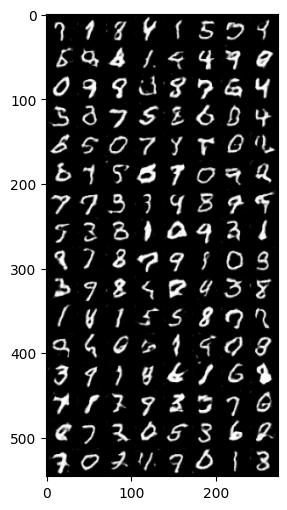

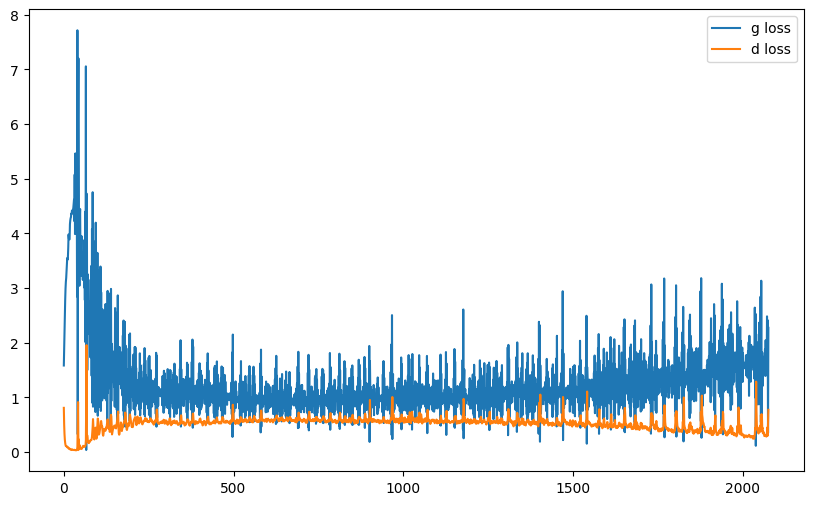

it: 2276; g_loss: 2.1150050163269043; d_loss: 0.2468208372592926; avg_real_score: 0.8271961212158203; avg_fake_score: 0.2512558698654175: : 400it [00:50,  8.98it/s]    

generated images


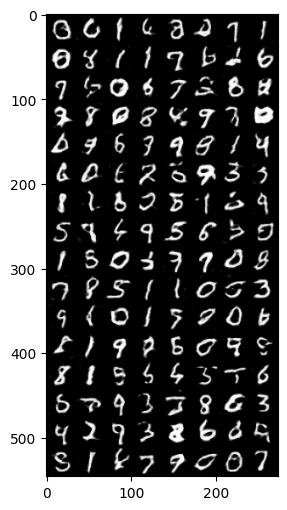

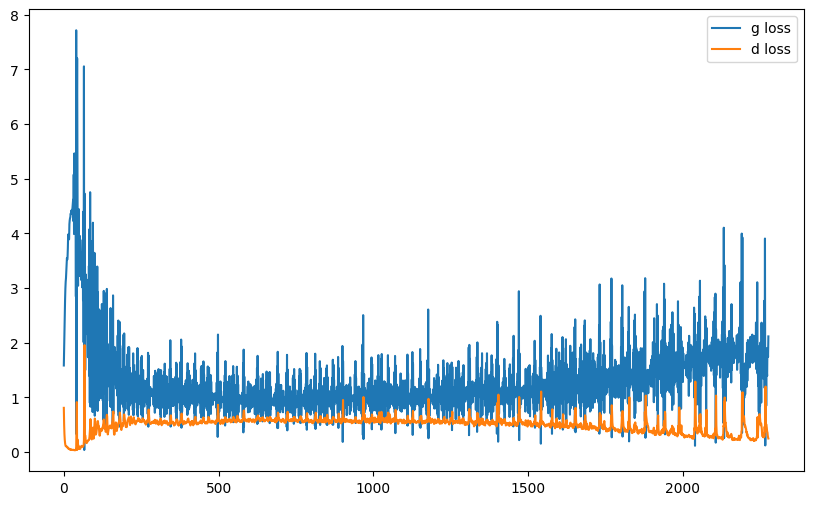

it: 2344; g_loss: 2.887600898742676; d_loss: 0.6466912031173706; avg_real_score: 0.9333426356315613; avg_fake_score: 0.6802726984024048: : 469it [00:59,  7.93it/s]    


In [82]:
nb_epochs = 5

g_losses = []
d_losses = []
torch.autograd.set_detect_anomaly(True)


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]
        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)
        
        real_loss = criterion(yhat_real, get_labels_one(cur_batch_size))
        fake_loss = criterion(yhat_fake, get_labels_zero(cur_batch_size))
    
        ###
        ### Discriminator
        ###

        d_loss = (real_loss + fake_loss) / 2
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        ###
        ### Generator
        ###

        g_loss = criterion(netD(fake_im), get_labels_one(cur_batch_size))#      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

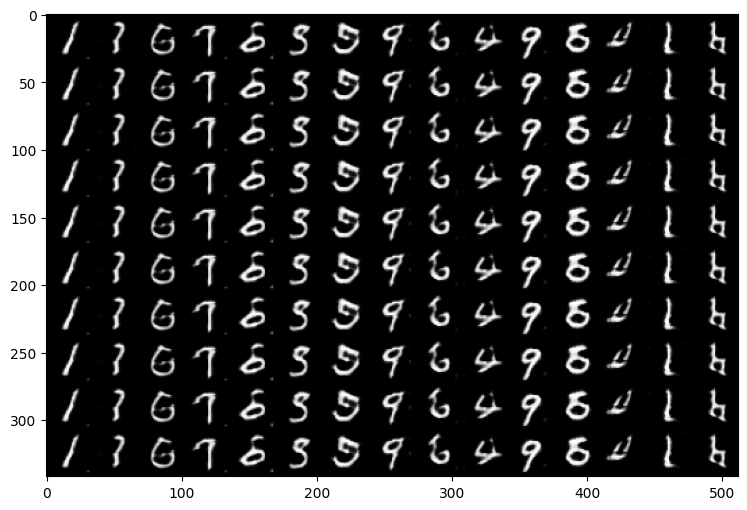

In [84]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

fake_ims = netG(z)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()

## 3.4 further experiences
- ### replace the generation loss with the 'true' loss

In [96]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

it: 0; g_loss: 0.25005078315734863; d_loss: 0.778886616230011; avg_real_score: 0.36676865816116333; avg_fake_score: 0.40883827209472656: : 0it [00:00, ?it/s]

generated images


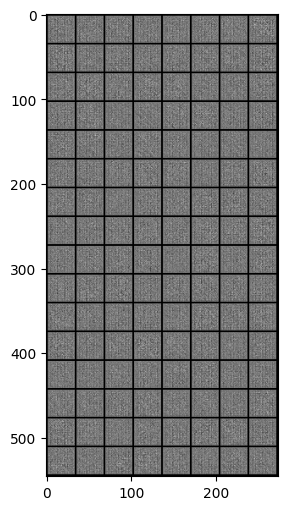

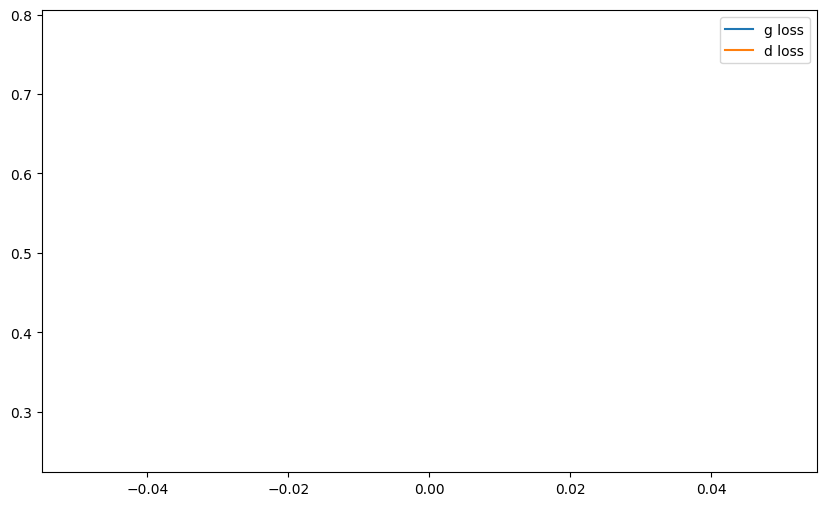

it: 200; g_loss: 0.5897272825241089; d_loss: 0.6816806197166443; avg_real_score: 0.5191431641578674; avg_fake_score: 0.47974175214767456: : 200it [00:18, 10.50it/s]     

generated images


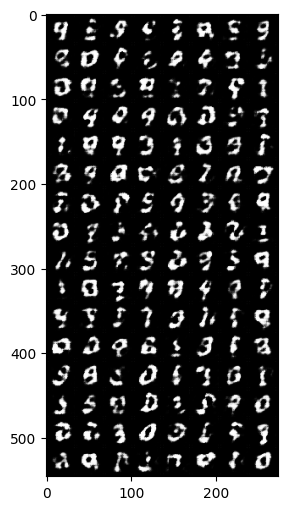

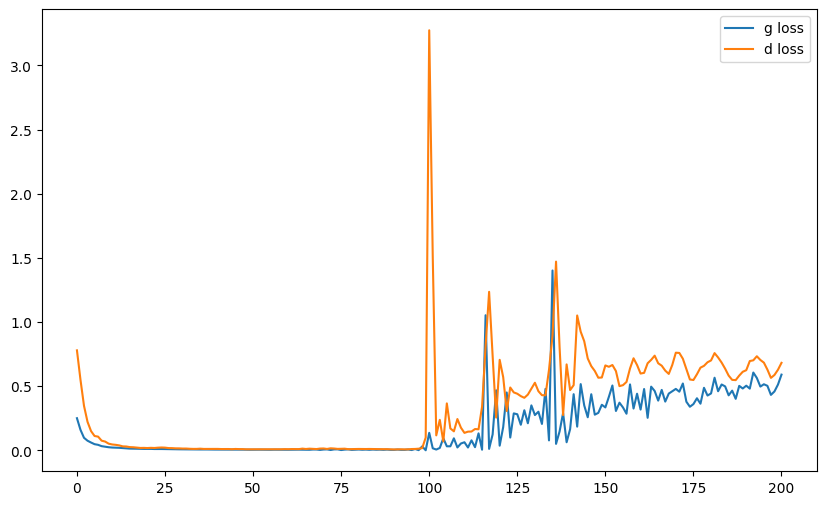

it: 400; g_loss: 0.47966641187667847; d_loss: 0.6109142303466797; avg_real_score: 0.508883535861969; avg_fake_score: 0.40204352140426636: : 400it [00:36, 10.97it/s] 

generated images


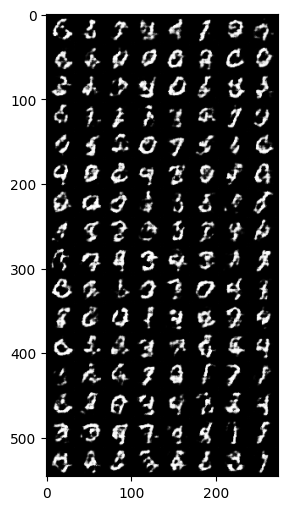

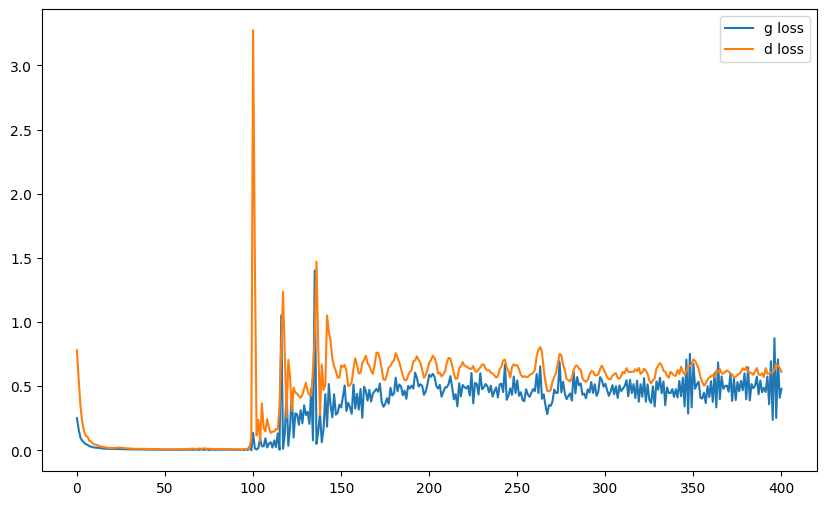

it: 468; g_loss: 0.579276442527771; d_loss: 0.6008785963058472; avg_real_score: 0.5210129618644714; avg_fake_score: 0.4066116213798523: : 469it [00:43, 10.90it/s]   
it: 469; g_loss: 0.38516026735305786; d_loss: 0.5842019319534302; avg_real_score: 0.6160697937011719; avg_fake_score: 0.47897493839263916: : 0it [00:00, ?it/s]

generated images


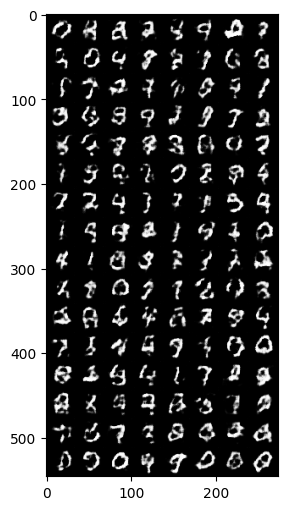

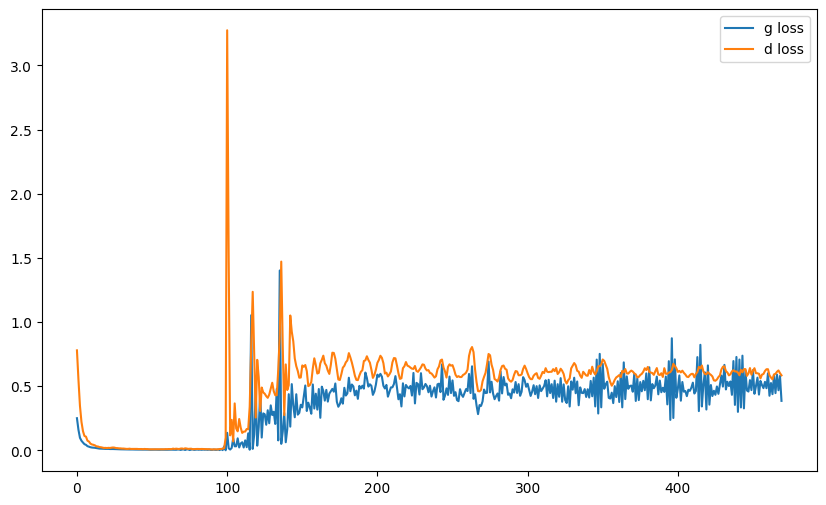

it: 669; g_loss: 0.5995755195617676; d_loss: 0.6371841430664062; avg_real_score: 0.5191009640693665; avg_fake_score: 0.44772928953170776: : 200it [00:18, 10.53it/s] 

generated images


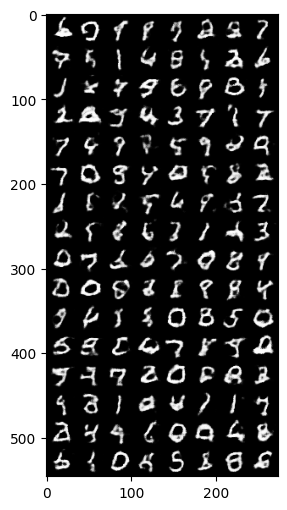

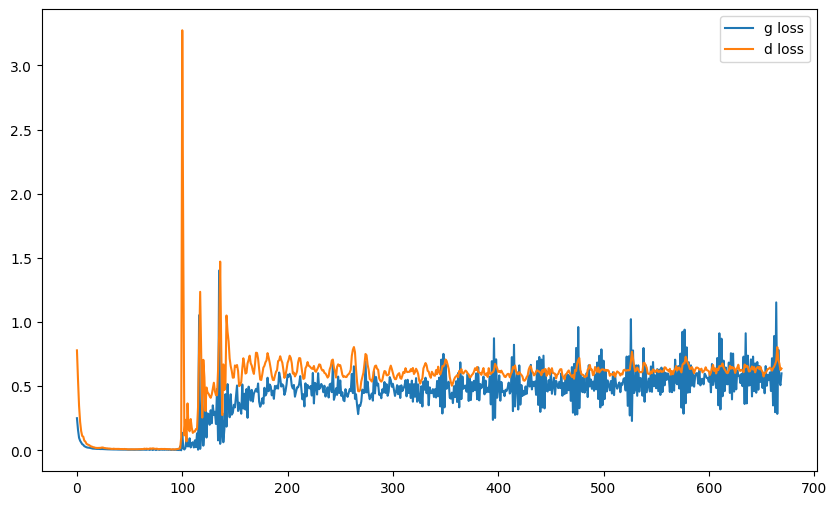

it: 869; g_loss: 0.6056822538375854; d_loss: 0.6007281541824341; avg_real_score: 0.5154998302459717; avg_fake_score: 0.40421628952026367: : 400it [00:36, 11.59it/s] 

generated images


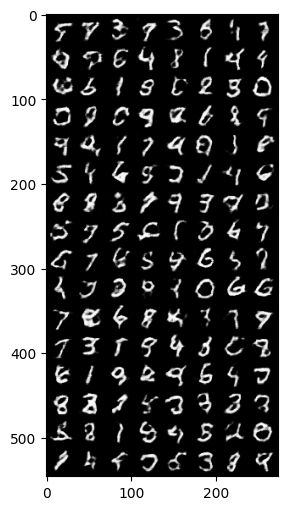

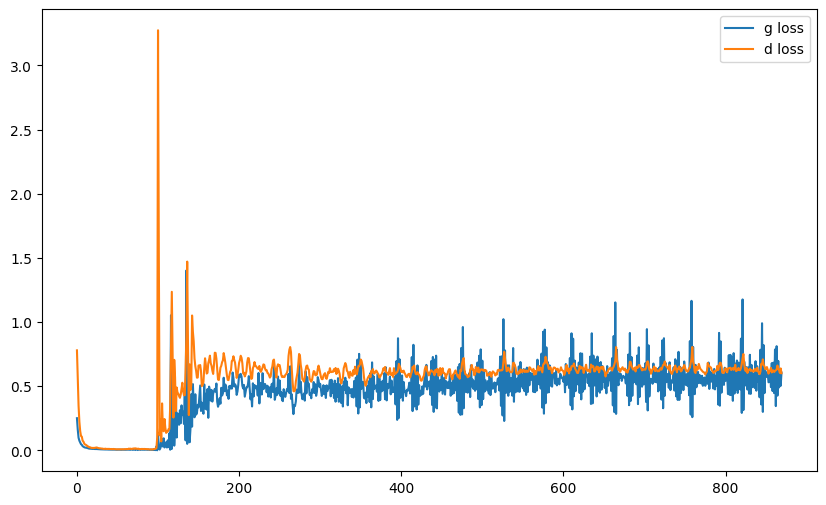

it: 937; g_loss: 0.554428219795227; d_loss: 0.6062862873077393; avg_real_score: 0.5103147029876709; avg_fake_score: 0.39575451612472534: : 469it [00:42, 10.97it/s]  
it: 938; g_loss: 0.5828164219856262; d_loss: 0.6219445466995239; avg_real_score: 0.5613573789596558; avg_fake_score: 0.46880459785461426: : 0it [00:00, ?it/s]

generated images


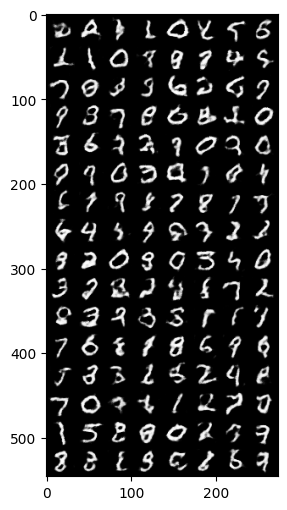

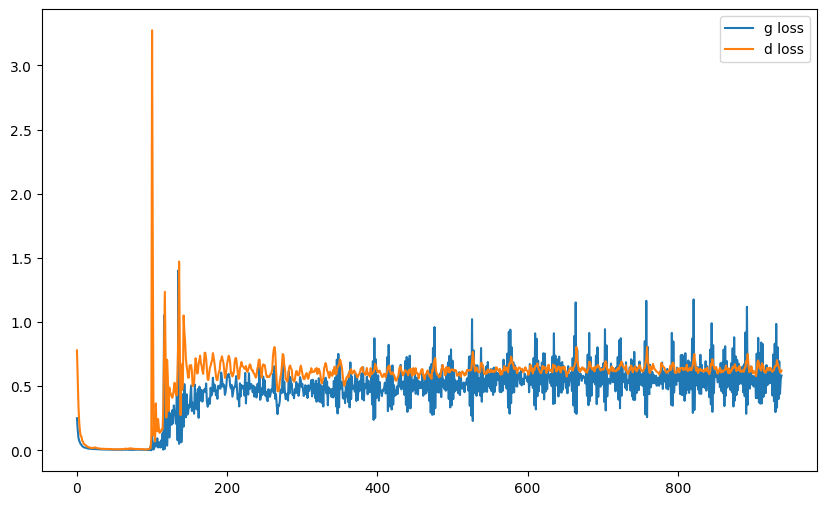

it: 1138; g_loss: 0.3829802870750427; d_loss: 0.6021926403045654; avg_real_score: 0.5529606938362122; avg_fake_score: 0.44266557693481445: : 200it [00:18, 11.42it/s] 

generated images


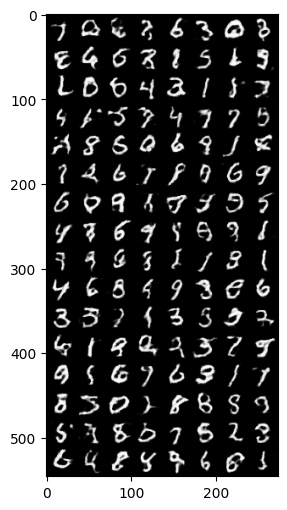

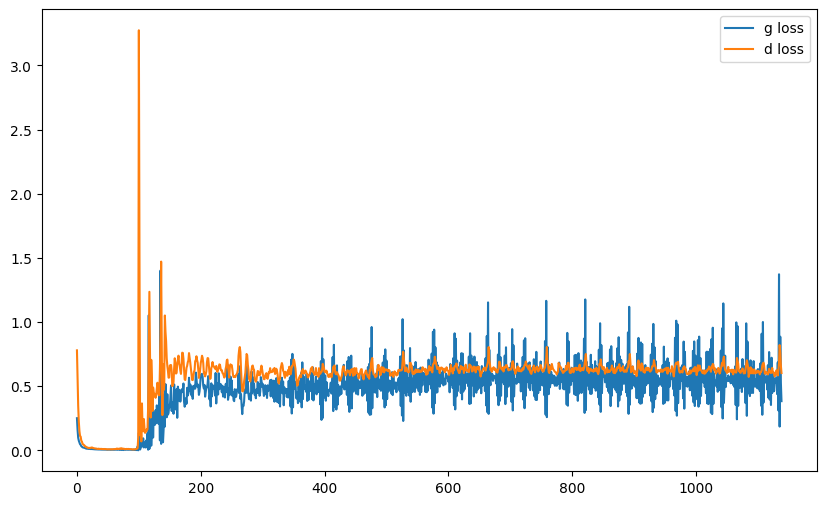

it: 1338; g_loss: 0.5187657475471497; d_loss: 0.608038067817688; avg_real_score: 0.5747084617614746; avg_fake_score: 0.47255080938339233: : 400it [00:36, 10.37it/s]  

generated images


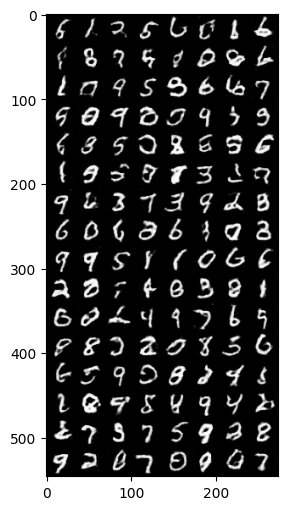

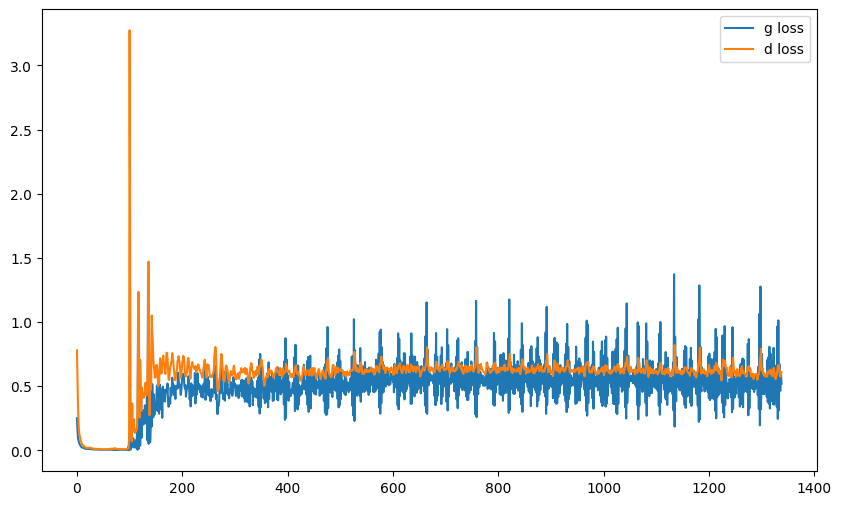

it: 1406; g_loss: 0.6759902834892273; d_loss: 0.5783116817474365; avg_real_score: 0.44698017835617065; avg_fake_score: 0.2779616713523865: : 469it [00:43, 10.90it/s]  
it: 1407; g_loss: 0.4649192988872528; d_loss: 0.5783558487892151; avg_real_score: 0.6548817753791809; avg_fake_score: 0.5008724927902222: : 0it [00:00, ?it/s]

generated images


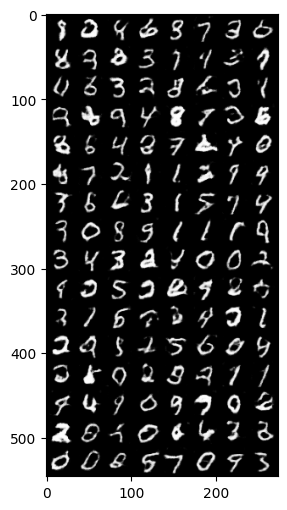

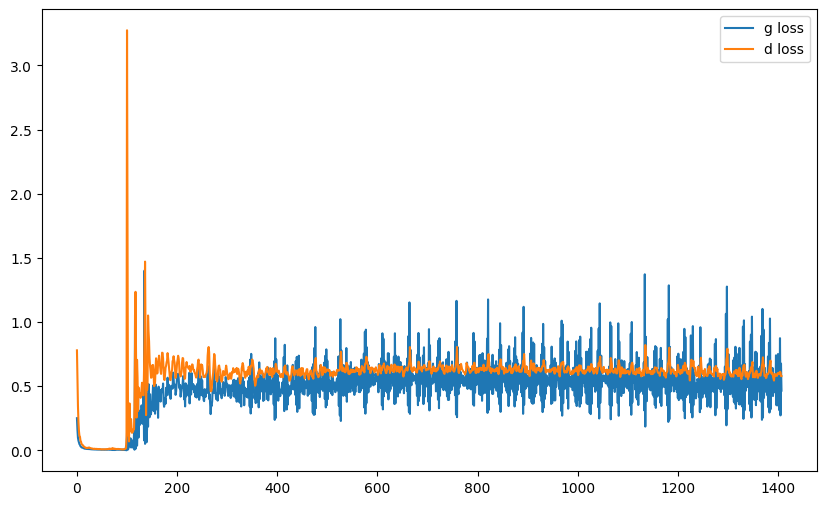

it: 1607; g_loss: 0.4974284768104553; d_loss: 0.5720379948616028; avg_real_score: 0.6137100458145142; avg_fake_score: 0.46570688486099243: : 200it [00:18, 10.51it/s] 

generated images


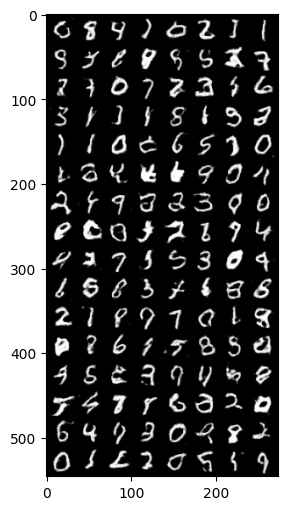

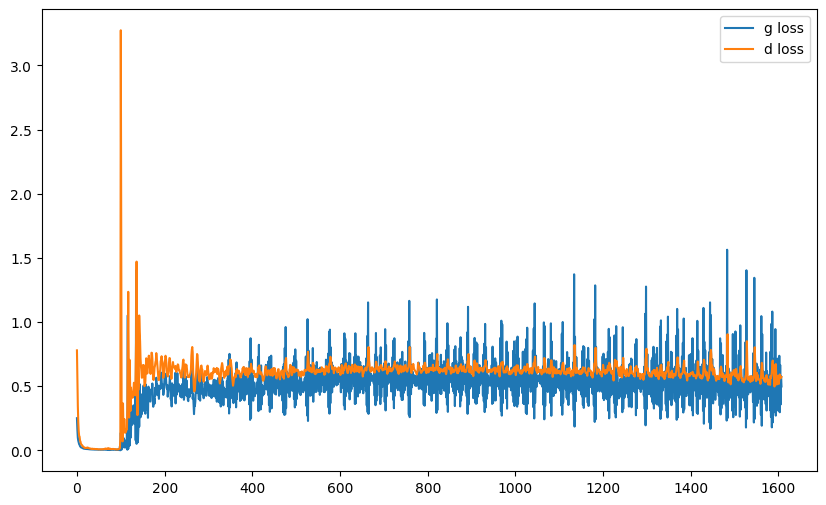

it: 1807; g_loss: 0.2894234359264374; d_loss: 0.46922802925109863; avg_real_score: 0.7588178515434265; avg_fake_score: 0.4711195230484009: : 400it [00:37, 11.07it/s]  

generated images


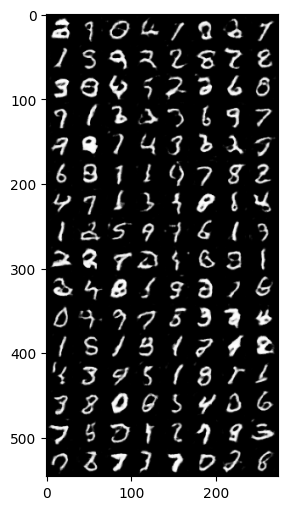

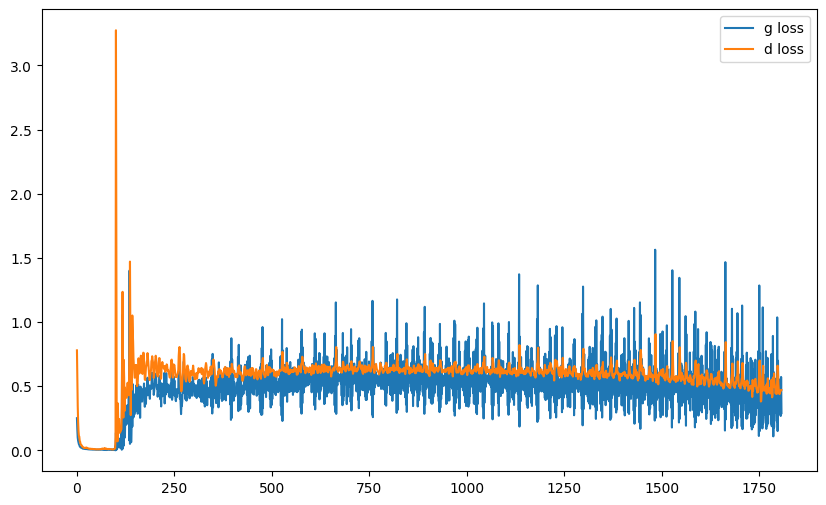

it: 1875; g_loss: 0.298173725605011; d_loss: 0.3697824478149414; avg_real_score: 0.6093276739120483; avg_fake_score: 0.19980375468730927: : 469it [00:43, 10.80it/s]   
it: 1876; g_loss: 0.22271445393562317; d_loss: 0.37796252965927124; avg_real_score: 0.7434264421463013; avg_fake_score: 0.3553094267845154: : 0it [00:00, ?it/s]

generated images


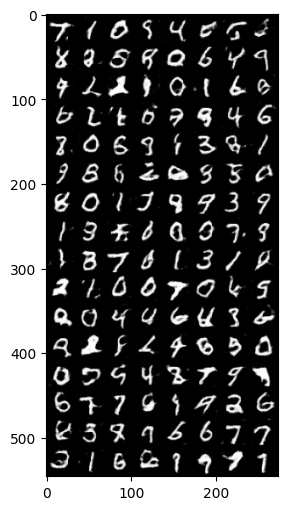

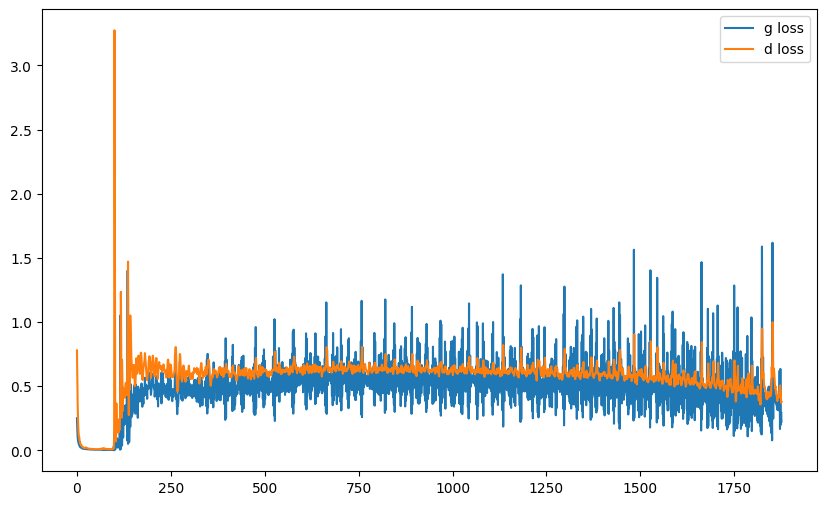

it: 2076; g_loss: 0.1451737880706787; d_loss: 0.36587488651275635; avg_real_score: 0.812063455581665; avg_fake_score: 0.3904966711997986: : 200it [00:18, 10.83it/s]   

generated images


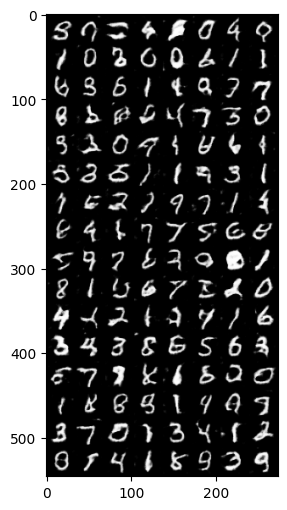

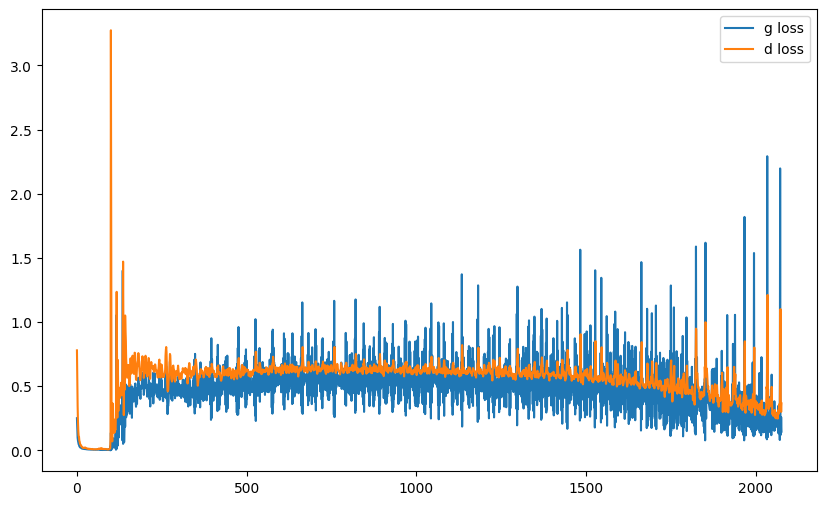

it: 2276; g_loss: 0.11377499997615814; d_loss: 0.15387281775474548; avg_real_score: 0.8880929946899414; avg_fake_score: 0.16557815670967102: : 400it [00:36, 11.22it/s] 

generated images


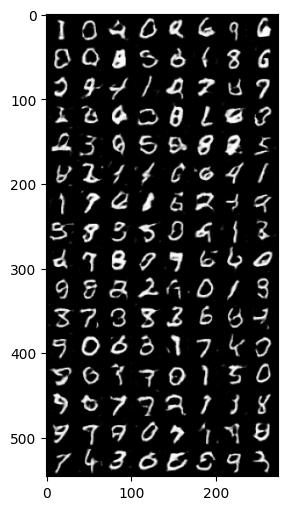

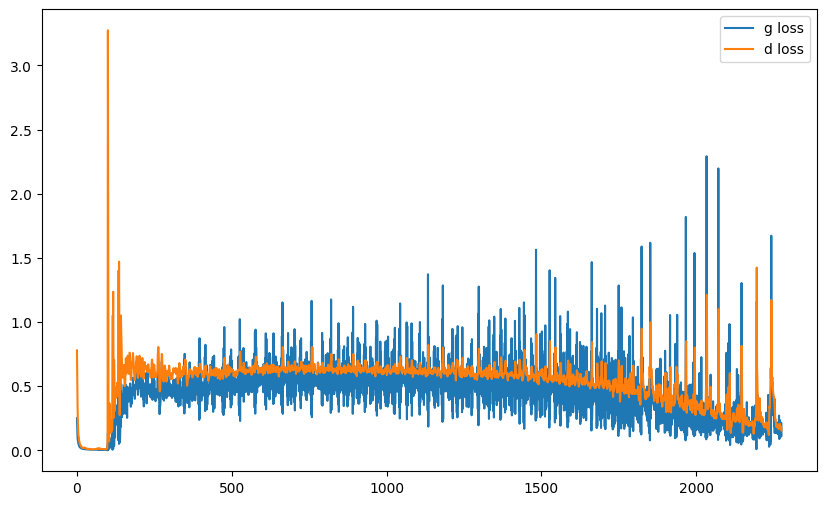

it: 2344; g_loss: 0.15796616673469543; d_loss: 0.148606538772583; avg_real_score: 0.8364192843437195; avg_fake_score: 0.10672831535339355: : 469it [00:42, 10.92it/s]  


In [97]:
nb_epochs = 5

g_losses = []
d_losses = []
torch.autograd.set_detect_anomaly(True)


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]
        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)
        
        real_loss = criterion(yhat_real, get_labels_one(cur_batch_size))
        fake_loss = criterion(yhat_fake, get_labels_zero(cur_batch_size))
    
        ###
        ### Discriminator
        ###

        d_loss = (real_loss + fake_loss) / 2
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        ###
        ### Generator
        ###

        g_loss = -criterion(netD(fake_im), get_labels_zero(cur_batch_size))#      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.abs().item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss.abs()}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

- ### Using two samples

In [ ]:
n_ex = 15
n_classes = 10
alpha = 0.6

z1 = torch.cat([sample_z(n_ex, nz) for i in range(10)])
z2 = torch.cat([sample_z(n_ex, nz) for i in range(10)])

netG.eval()

fake_ims1 = netG(z1)
fake_ims2 = netG(z2)

fake_ims = alpha * fake_ims1 + (1 - alpha) * fake_ims2

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()

- ### Using CIFAR-10 dataset


In [7]:
cifar = torchvision.datasets.CIFAR10(root='.', download=True, transform=transforms.Compose([
    transforms.ToTensor()
]))
cifar_dataloader = DataLoader(dataset=cifar, batch_size=batch_size, shuffle=True)

Files already downloaded and verified


In [18]:
nz = 100
ngf = 32
ndf = 32

nchannels = 3
lr_d = 0.0002
lr_g = 0.0005
beta1 = 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf, nchannels).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
nb_epochs = 20



it: 0; g_loss: 1.2691717147827148; d_loss: 0.781383752822876; avg_real_score: 0.48996102809906006; avg_fake_score: 0.5549800395965576: : 0it [00:00, ?it/s]

generated images


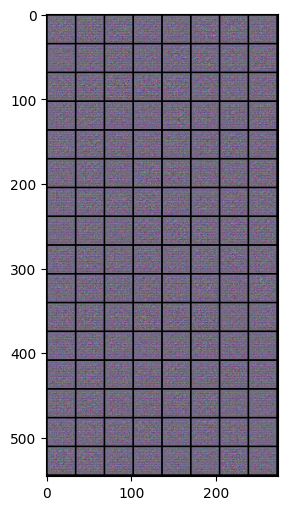

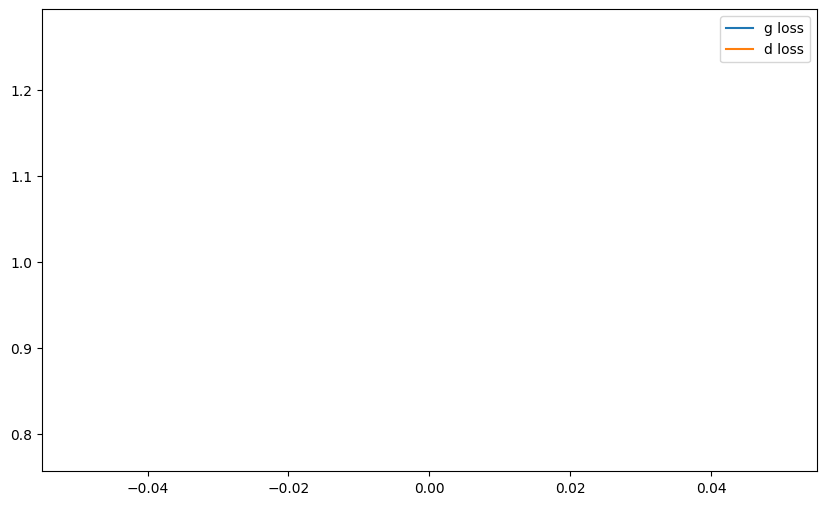

it: 200; g_loss: 1.4501230716705322; d_loss: 0.4455232322216034; avg_real_score: 0.6059952974319458; avg_fake_score: 0.3021542429924011: : 199it [00:14, 12.34it/s]  

generated images


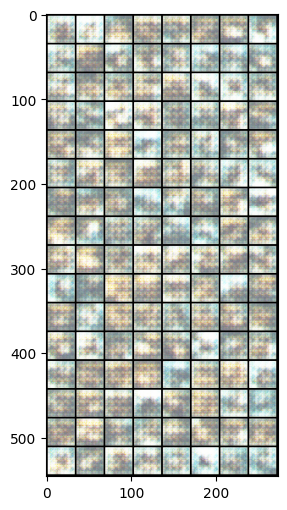

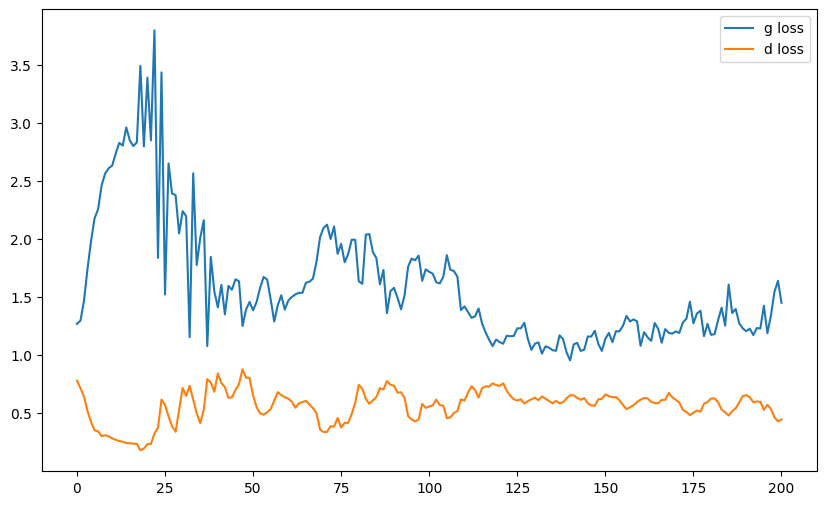

it: 390; g_loss: 1.3270753622055054; d_loss: 0.5008983612060547; avg_real_score: 0.630556583404541; avg_fake_score: 0.4012463688850403: : 391it [00:30, 12.93it/s]   
it: 391; g_loss: 1.1585205793380737; d_loss: 0.5317227840423584; avg_real_score: 0.5685852766036987; avg_fake_score: 0.37273848056793213: : 0it [00:00, ?it/s]

generated images


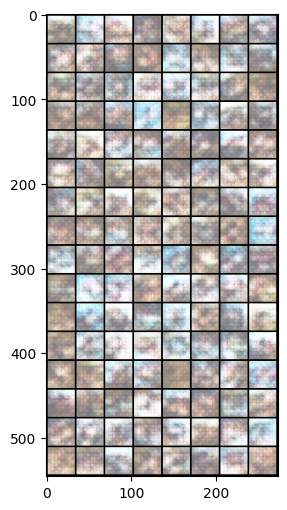

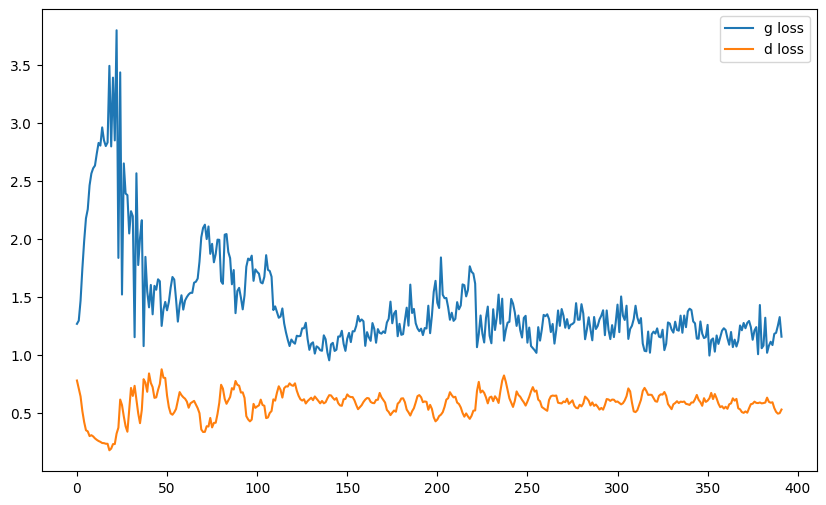

it: 591; g_loss: 1.2301174402236938; d_loss: 0.5911261439323425; avg_real_score: 0.6166219711303711; avg_fake_score: 0.48688459396362305: : 199it [00:16, 12.08it/s]

generated images


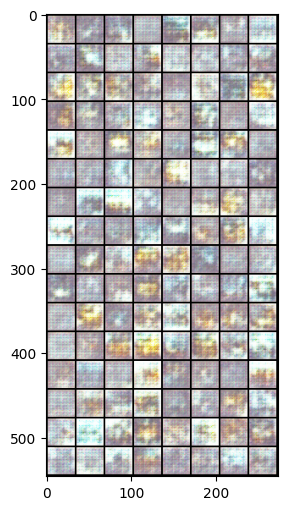

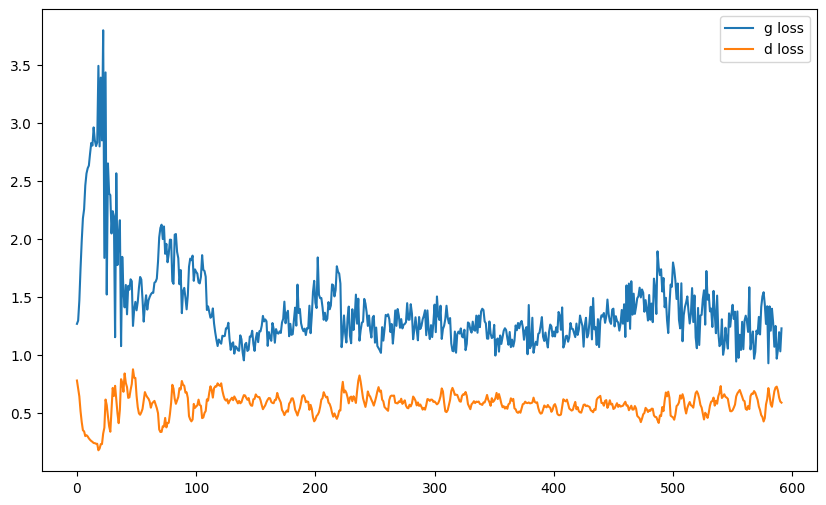

it: 781; g_loss: 1.7152312994003296; d_loss: 0.5771574378013611; avg_real_score: 0.6894544959068298; avg_fake_score: 0.524937629699707: : 391it [00:32, 12.01it/s]   
it: 782; g_loss: 0.7800450325012207; d_loss: 0.6601443886756897; avg_real_score: 0.41191720962524414; avg_fake_score: 0.31795647740364075: : 0it [00:00, ?it/s]

generated images


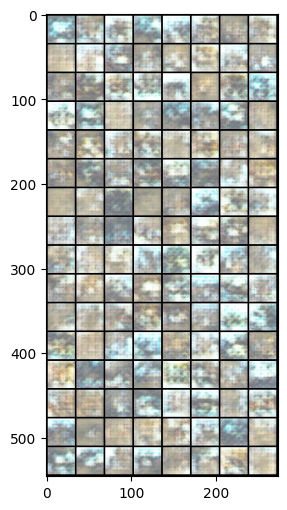

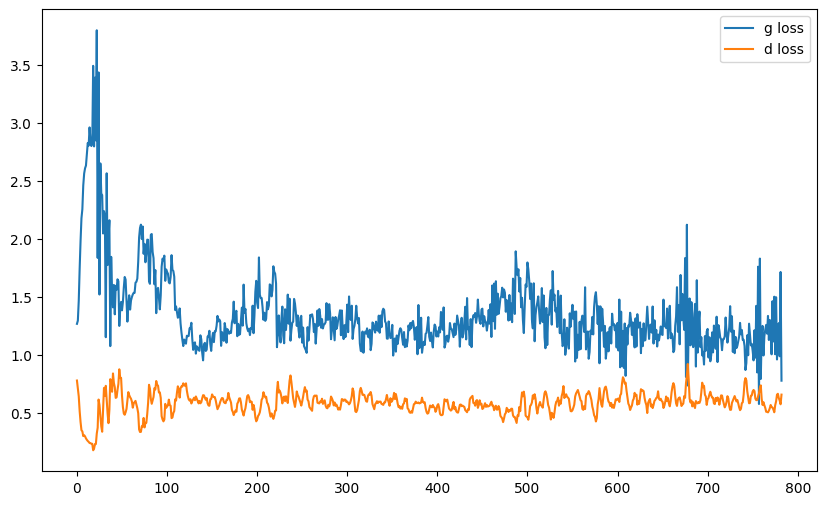

it: 982; g_loss: 1.179347038269043; d_loss: 0.6369748115539551; avg_real_score: 0.5724292397499084; avg_fake_score: 0.488836407661438: : 199it [00:17, 11.25it/s]    

generated images


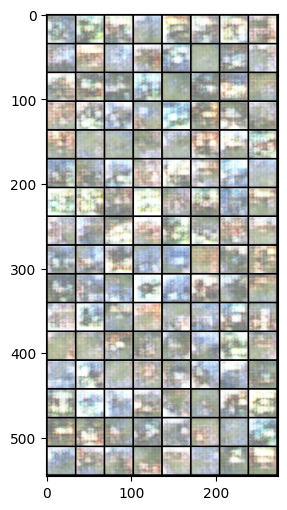

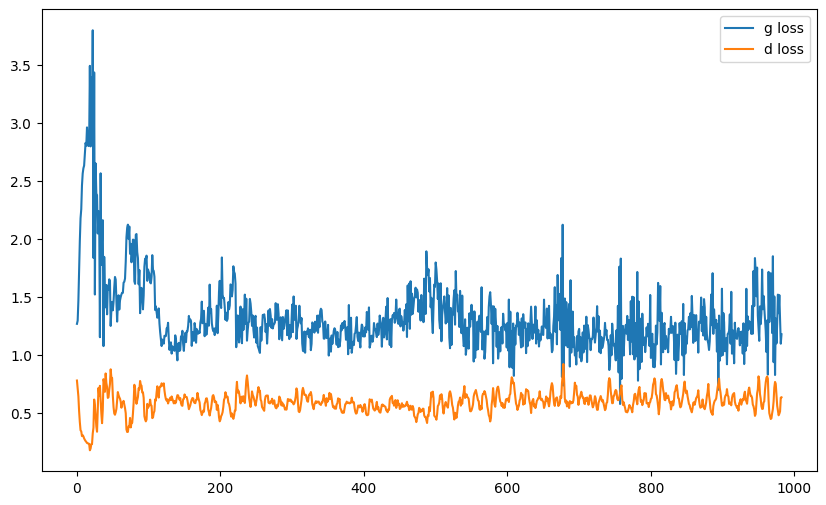

it: 1172; g_loss: 1.2727514505386353; d_loss: 0.5962463617324829; avg_real_score: 0.533791184425354; avg_fake_score: 0.4054672420024872: : 391it [00:33, 11.67it/s]   
it: 1173; g_loss: 1.2645843029022217; d_loss: 0.5784500241279602; avg_real_score: 0.5667455196380615; avg_fake_score: 0.4238511323928833: : 0it [00:00, ?it/s]

generated images


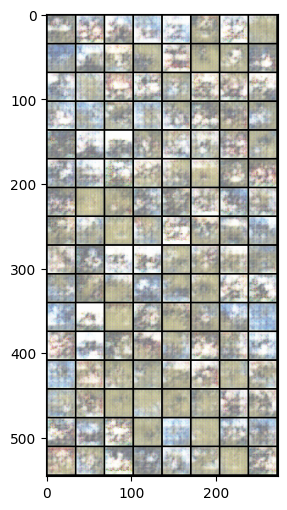

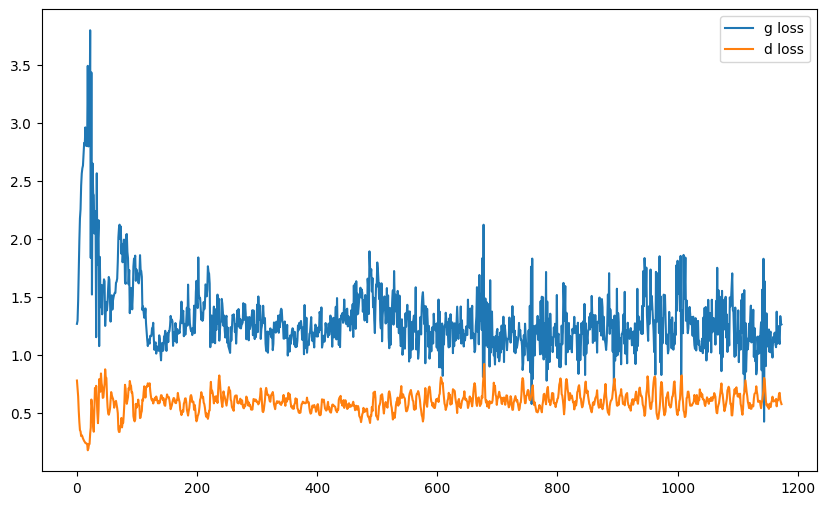

it: 1373; g_loss: 1.277510643005371; d_loss: 0.6484376788139343; avg_real_score: 0.5690606236457825; avg_fake_score: 0.4938174784183502: : 199it [00:16, 12.13it/s]   

generated images


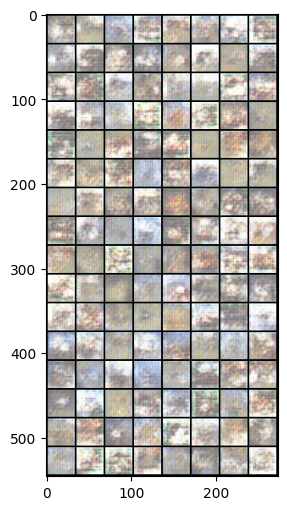

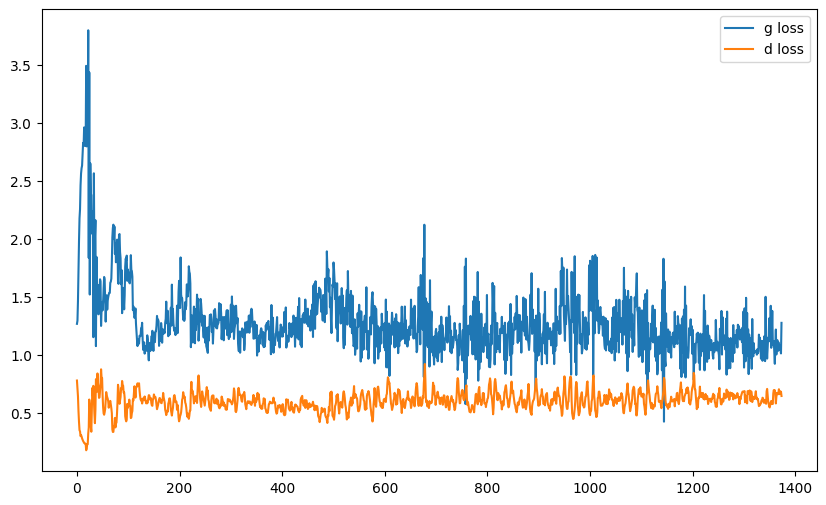

it: 1563; g_loss: 1.074444055557251; d_loss: 0.6219526529312134; avg_real_score: 0.5297471880912781; avg_fake_score: 0.4346074163913727: : 391it [00:32, 11.87it/s]   
it: 1564; g_loss: 1.2297215461730957; d_loss: 0.603552520275116; avg_real_score: 0.560012936592102; avg_fake_score: 0.436428964138031: : 0it [00:00, ?it/s]

generated images


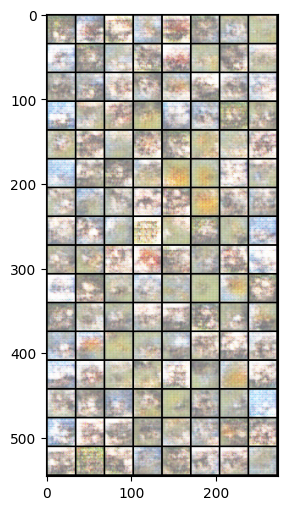

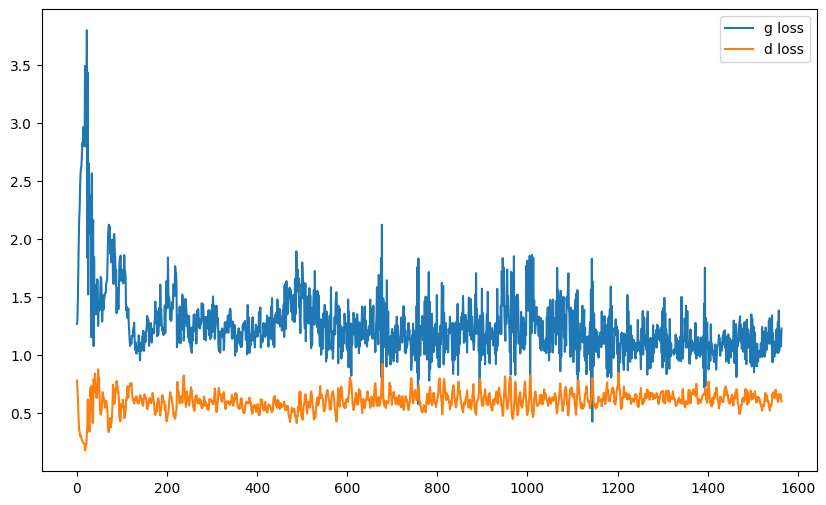

it: 1764; g_loss: 0.8770318031311035; d_loss: 0.6944028735160828; avg_real_score: 0.5016749501228333; avg_fake_score: 0.48053663969039917: : 199it [00:16, 12.55it/s] 

generated images


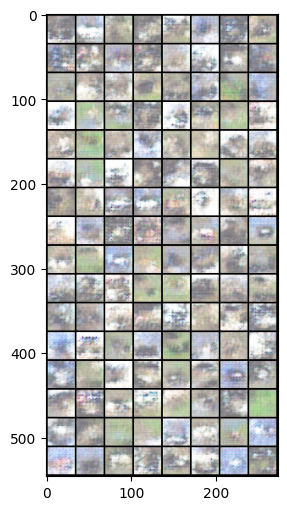

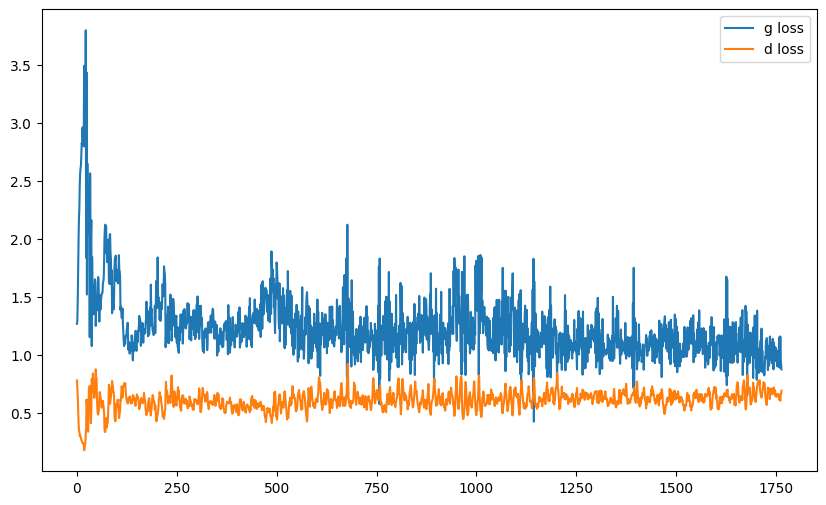

it: 1954; g_loss: 0.911071240901947; d_loss: 0.7417739629745483; avg_real_score: 0.5094490051269531; avg_fake_score: 0.5268769264221191: : 391it [00:32, 11.91it/s]   
it: 1955; g_loss: 1.148714303970337; d_loss: 0.6653689742088318; avg_real_score: 0.5601333379745483; avg_fake_score: 0.5048294067382812: : 0it [00:00, ?it/s]

generated images


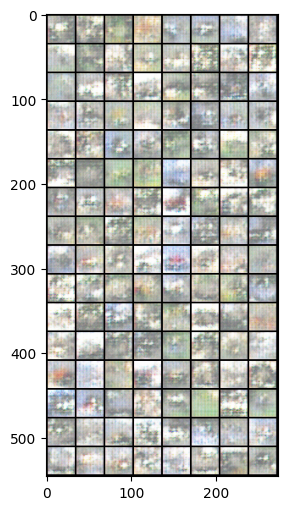

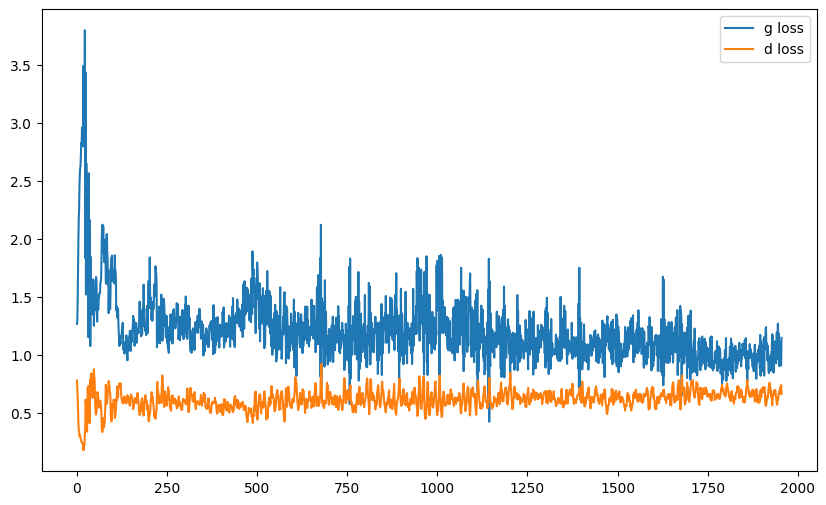

it: 2155; g_loss: 0.9199477434158325; d_loss: 0.6686044931411743; avg_real_score: 0.531764805316925; avg_fake_score: 0.4909810721874237: : 200it [00:16, 12.00it/s]   

generated images


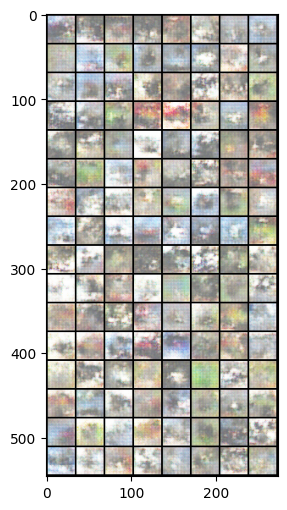

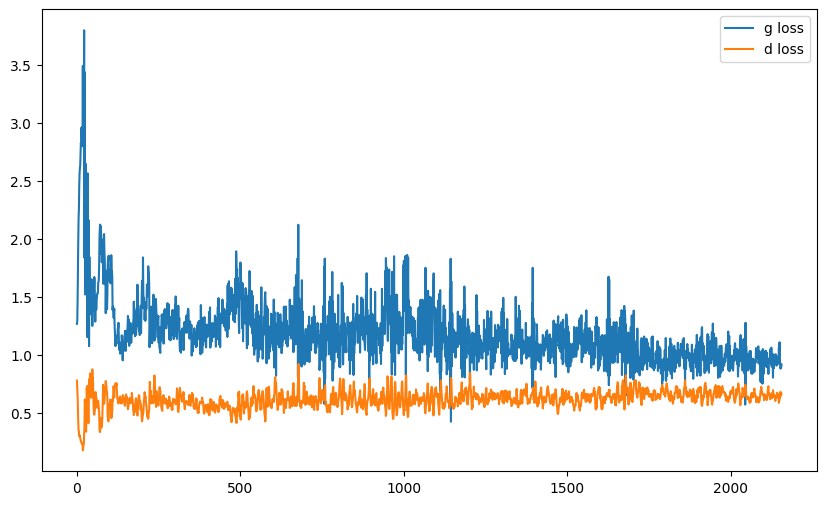

it: 2345; g_loss: 0.976991593837738; d_loss: 0.5683225989341736; avg_real_score: 0.5533343553543091; avg_fake_score: 0.3983243405818939: : 391it [00:33, 11.77it/s]   
it: 2346; g_loss: 1.082777976989746; d_loss: 0.5724087953567505; avg_real_score: 0.5879344940185547; avg_fake_score: 0.4437837600708008: : 0it [00:00, ?it/s]

generated images


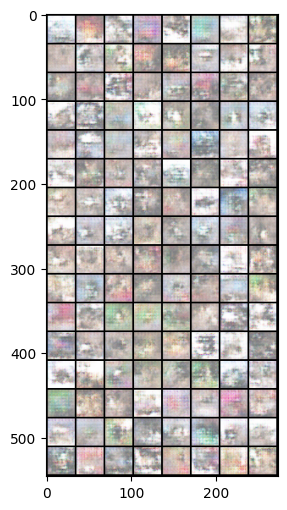

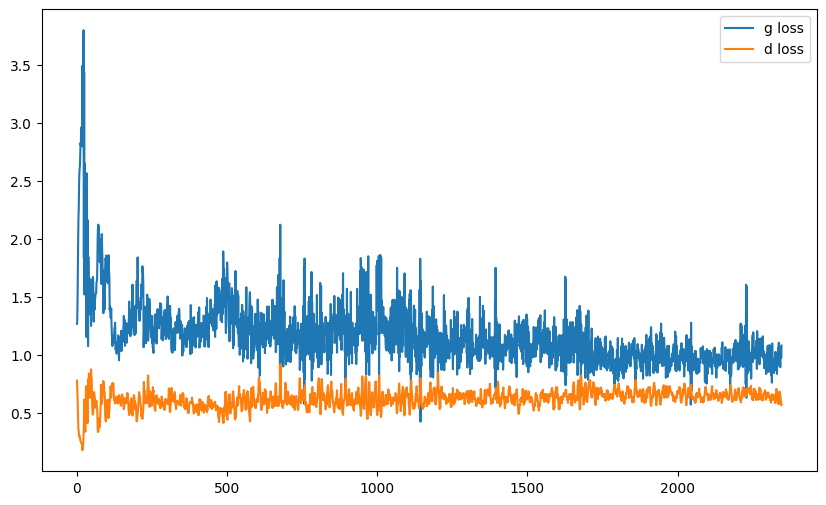

it: 2546; g_loss: 1.1958608627319336; d_loss: 0.6402869820594788; avg_real_score: 0.6115289926528931; avg_fake_score: 0.5195612907409668: : 199it [00:17, 10.53it/s]  

generated images


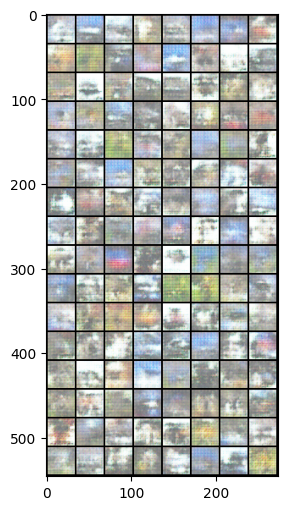

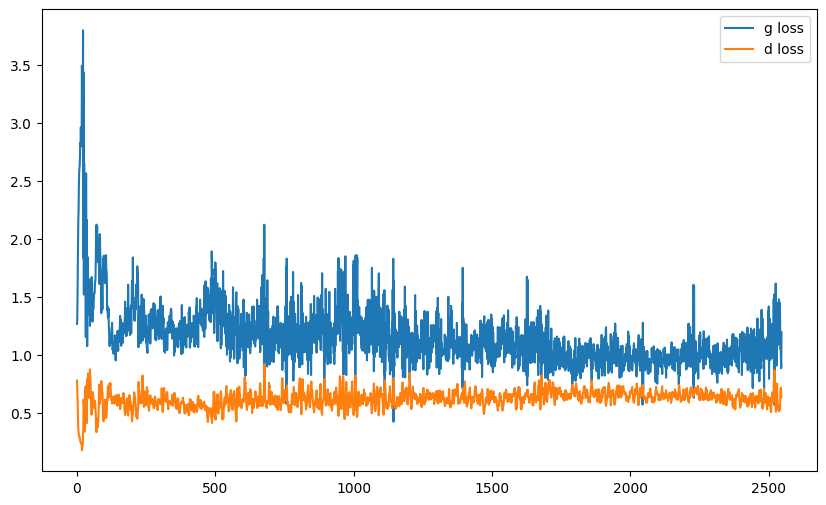

it: 2736; g_loss: 0.8798648715019226; d_loss: 0.7131960988044739; avg_real_score: 0.49189338088035583; avg_fake_score: 0.48518919944763184: : 391it [00:33, 11.83it/s]
it: 2737; g_loss: 0.8956093788146973; d_loss: 0.6806148886680603; avg_real_score: 0.526551365852356; avg_fake_score: 0.4925634264945984: : 0it [00:00, ?it/s]

generated images


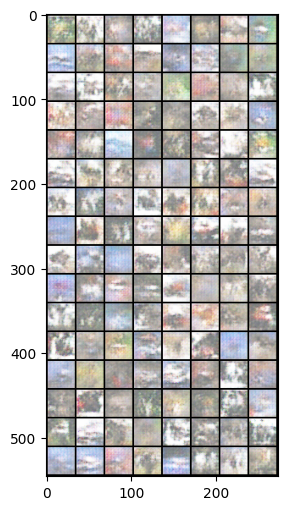

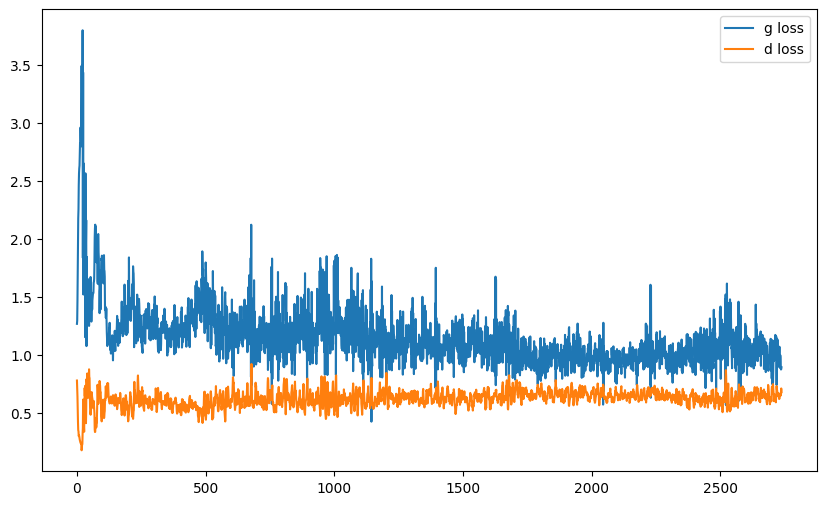

it: 2937; g_loss: 1.0240535736083984; d_loss: 0.6167913675308228; avg_real_score: 0.5604971647262573; avg_fake_score: 0.46223780512809753: : 199it [00:17, 11.24it/s] 

generated images


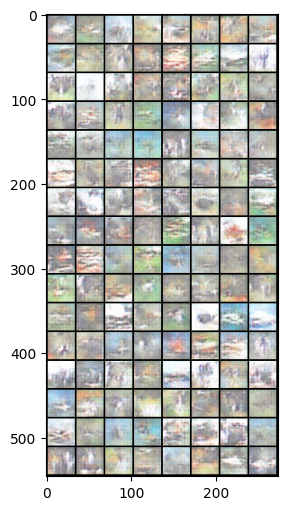

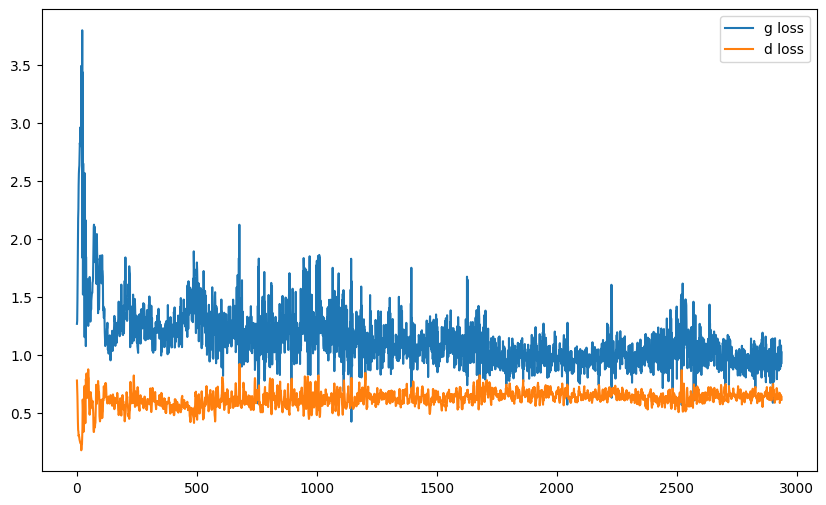

it: 3127; g_loss: 0.9083284735679626; d_loss: 0.7225742936134338; avg_real_score: 0.4697325825691223; avg_fake_score: 0.4695340692996979: : 391it [00:34, 11.19it/s]  
it: 3128; g_loss: 1.057110071182251; d_loss: 0.6555694341659546; avg_real_score: 0.5263717770576477; avg_fake_score: 0.46352291107177734: : 0it [00:00, ?it/s]

generated images


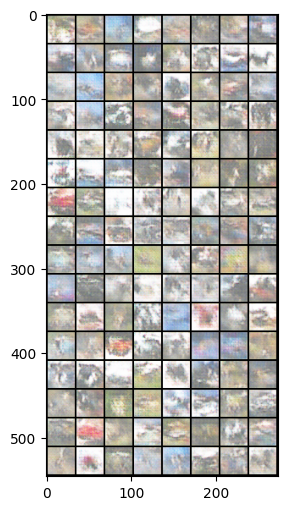

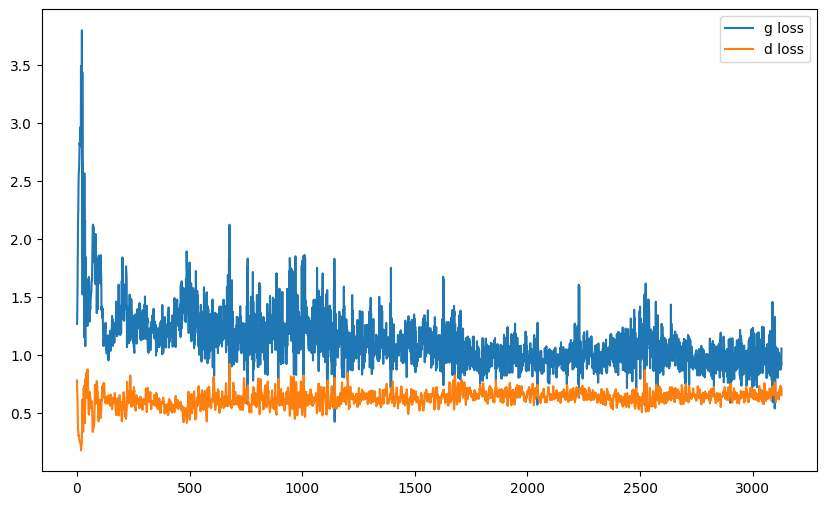

it: 3328; g_loss: 0.982385516166687; d_loss: 0.6597538590431213; avg_real_score: 0.5577412247657776; avg_fake_score: 0.5013151168823242: : 200it [00:17, 11.58it/s]   

generated images


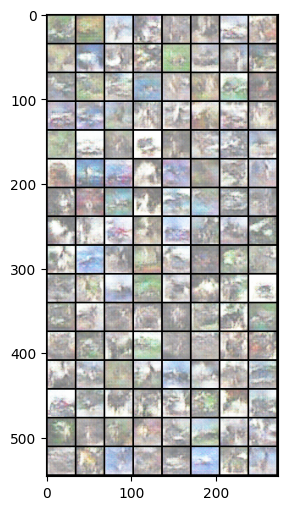

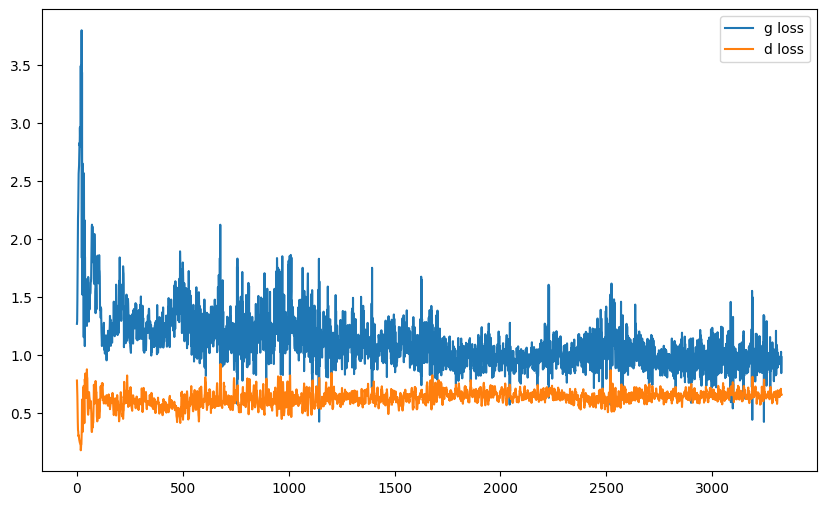

it: 3518; g_loss: 0.9360441565513611; d_loss: 0.6666256189346313; avg_real_score: 0.5515775680541992; avg_fake_score: 0.5034971237182617: : 391it [00:35, 11.15it/s]  
it: 3519; g_loss: 0.8116534948348999; d_loss: 0.664300799369812; avg_real_score: 0.5046824812889099; avg_fake_score: 0.45415911078453064: : 0it [00:00, ?it/s]

generated images


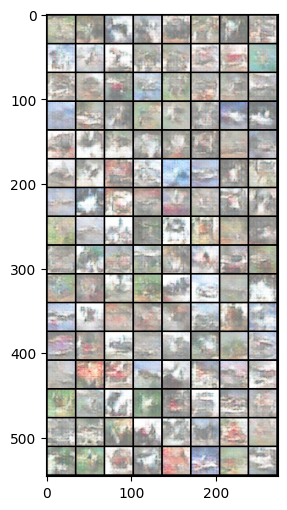

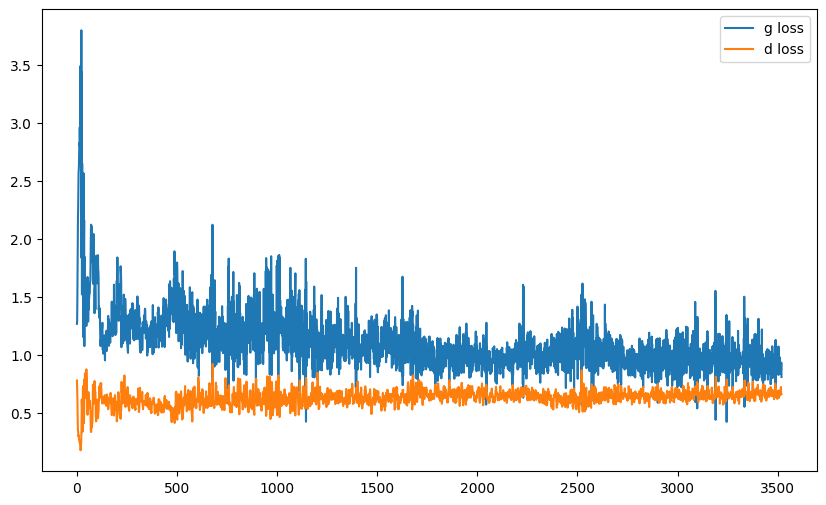

it: 3719; g_loss: 0.8434857130050659; d_loss: 0.6769472360610962; avg_real_score: 0.5650577545166016; avg_fake_score: 0.526732861995697: : 200it [00:19, 11.96it/s]   

generated images


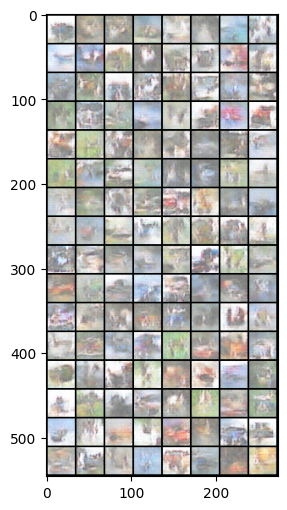

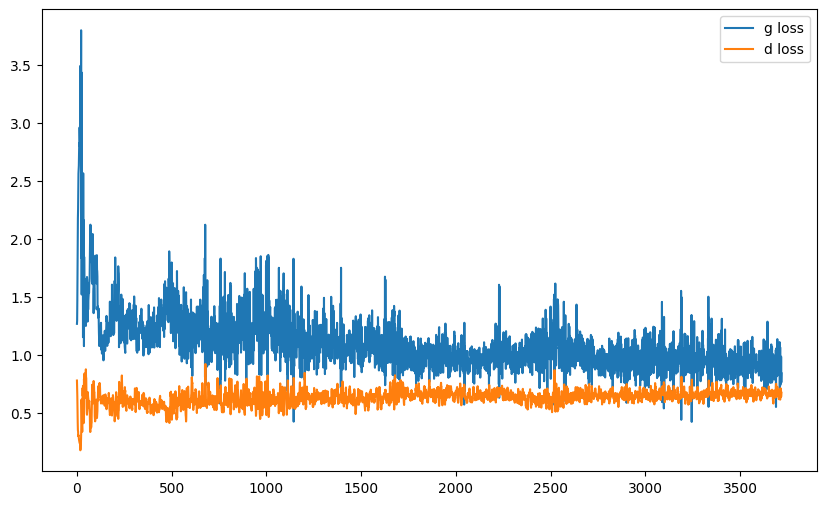

it: 3909; g_loss: 0.9255753755569458; d_loss: 0.6860459446907043; avg_real_score: 0.5339921116828918; avg_fake_score: 0.5088261961936951: : 391it [00:35, 10.97it/s]  
it: 3910; g_loss: 0.7420307993888855; d_loss: 0.6762617826461792; avg_real_score: 0.4879956841468811; avg_fake_score: 0.4491860568523407: : 0it [00:00, ?it/s]

generated images


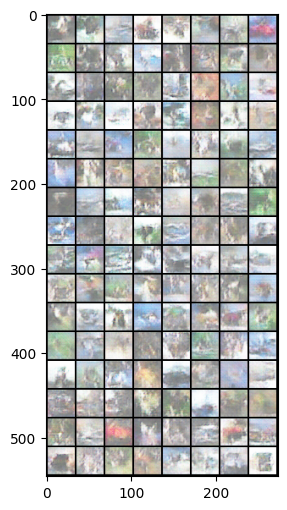

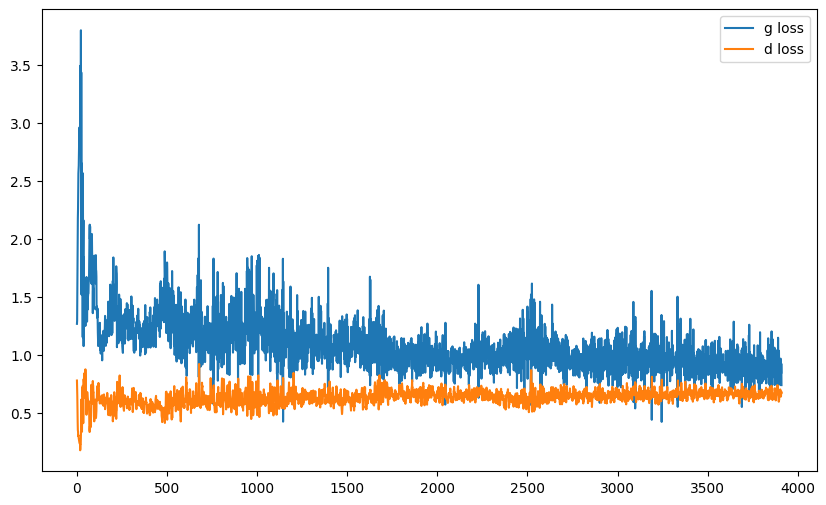

it: 4110; g_loss: 0.918363094329834; d_loss: 0.701642632484436; avg_real_score: 0.5281710624694824; avg_fake_score: 0.5174038410186768: : 200it [00:17, 11.39it/s]    

generated images


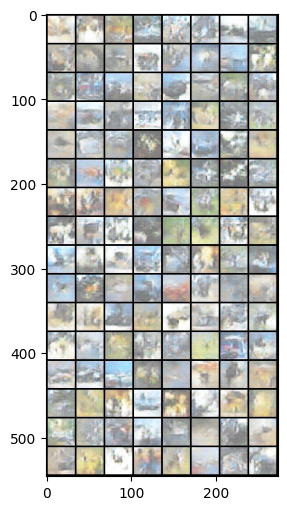

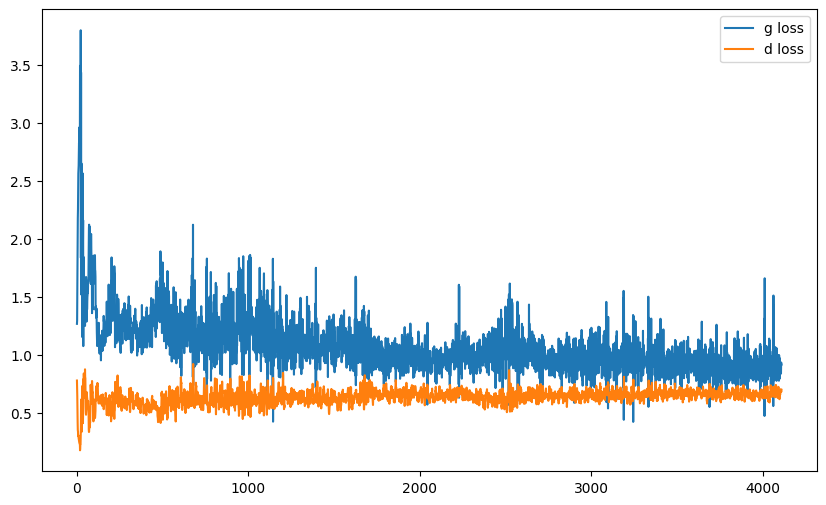

it: 4300; g_loss: 1.0133436918258667; d_loss: 0.652283787727356; avg_real_score: 0.5655243992805481; avg_fake_score: 0.5057559013366699: : 391it [00:33, 11.62it/s]    
it: 4301; g_loss: 0.8923583030700684; d_loss: 0.6544177532196045; avg_real_score: 0.4918144941329956; avg_fake_score: 0.43377596139907837: : 0it [00:00, ?it/s]

generated images


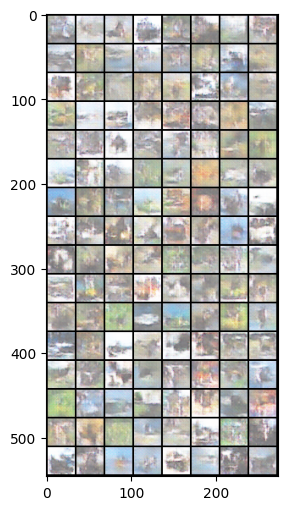

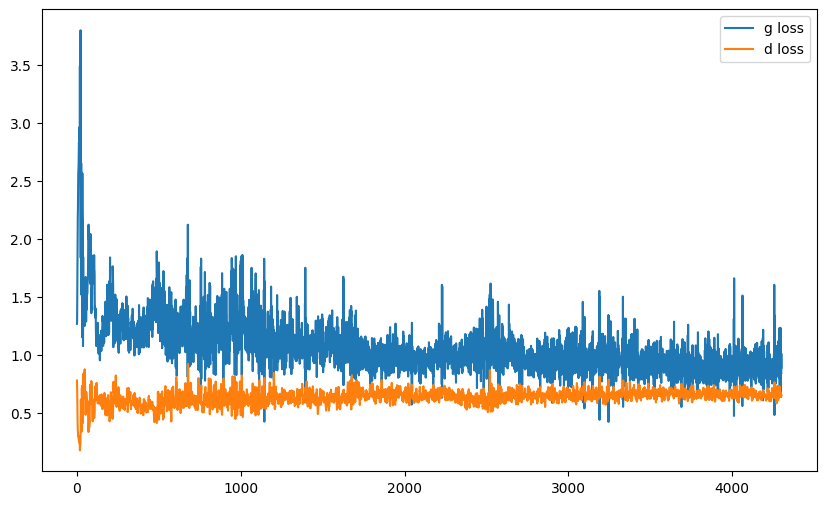

it: 4501; g_loss: 1.0169073343276978; d_loss: 0.6641057729721069; avg_real_score: 0.5486108064651489; avg_fake_score: 0.500151515007019: : 199it [00:17, 12.48it/s]   

generated images


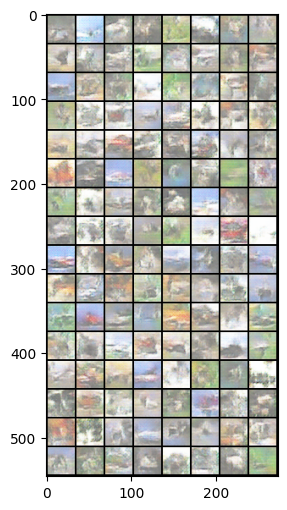

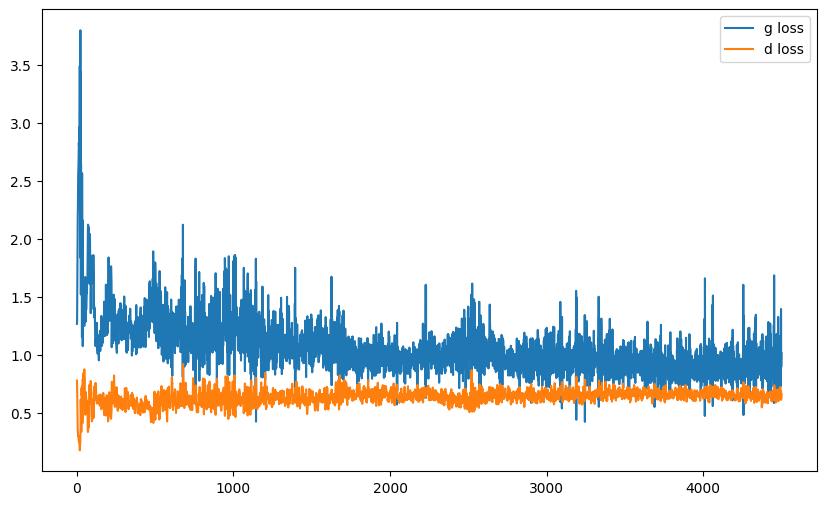

it: 4691; g_loss: 0.9329323172569275; d_loss: 0.7450427412986755; avg_real_score: 0.5297898650169373; avg_fake_score: 0.558554470539093: : 391it [00:33, 11.66it/s]   
it: 4692; g_loss: 0.9061976671218872; d_loss: 0.6993823051452637; avg_real_score: 0.4733429551124573; avg_fake_score: 0.4607428014278412: : 0it [00:00, ?it/s]

generated images


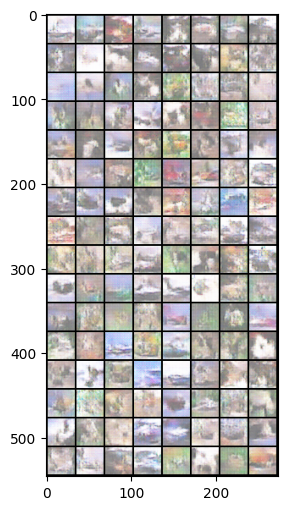

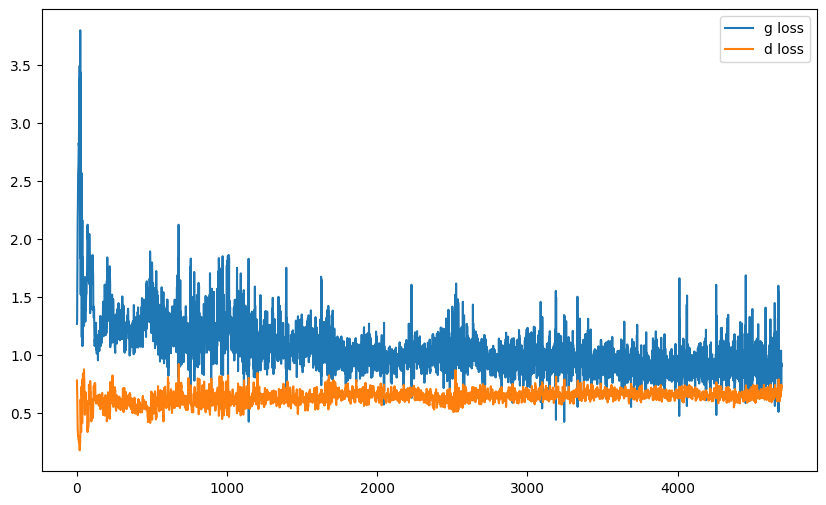

it: 4892; g_loss: 0.992952823638916; d_loss: 0.669651210308075; avg_real_score: 0.5888621807098389; avg_fake_score: 0.5436240434646606: : 200it [00:17, 11.78it/s]    

generated images


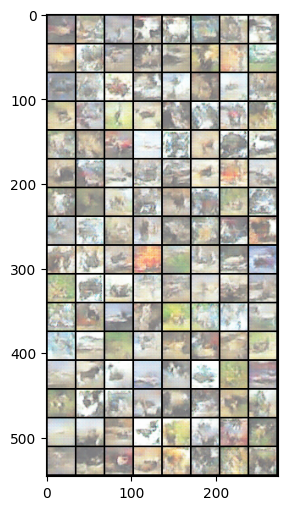

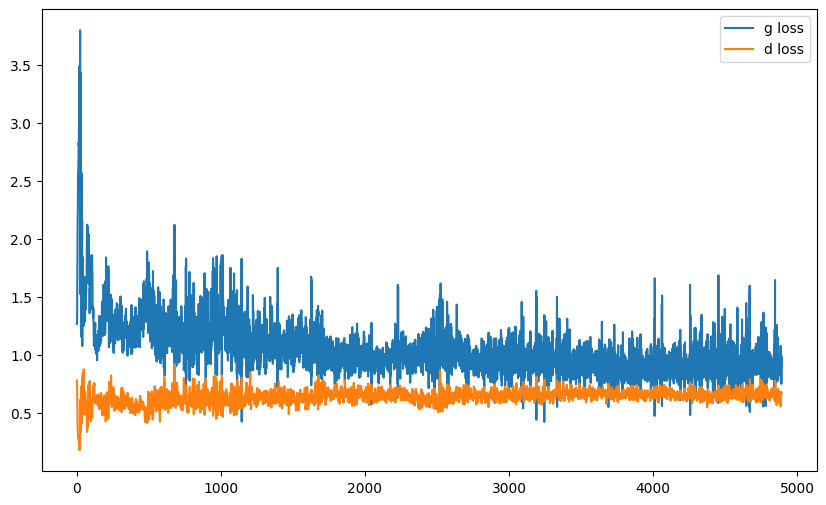

it: 5082; g_loss: 0.7590736150741577; d_loss: 0.6991993188858032; avg_real_score: 0.4633600413799286; avg_fake_score: 0.4479006826877594: : 391it [00:32, 11.87it/s]  
it: 5083; g_loss: 0.9735642671585083; d_loss: 0.6898255348205566; avg_real_score: 0.5842339396476746; avg_fake_score: 0.5530487298965454: : 0it [00:00, ?it/s]

generated images


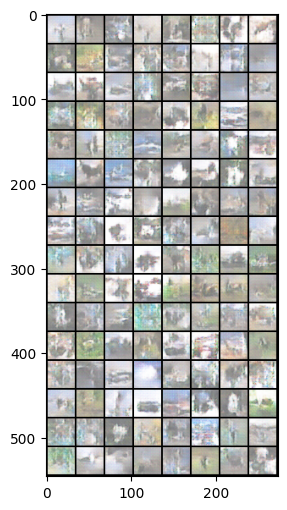

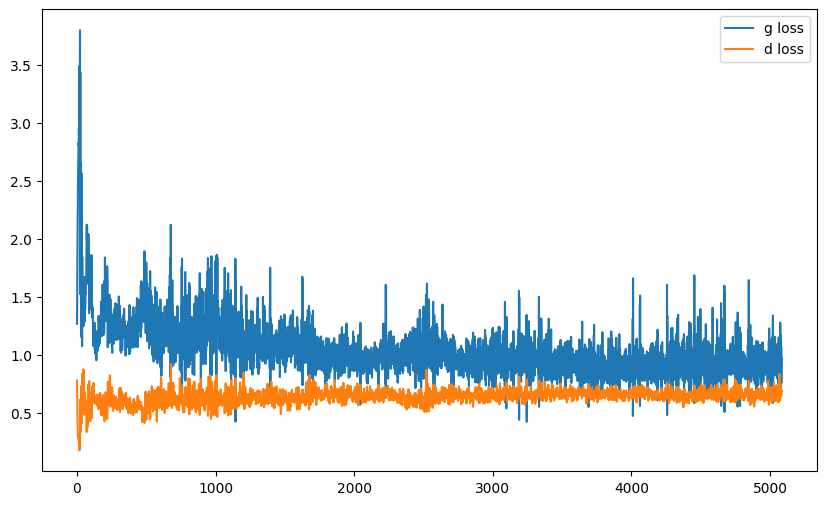

it: 5283; g_loss: 0.8149609565734863; d_loss: 0.623698890209198; avg_real_score: 0.524081826210022; avg_fake_score: 0.43416628241539: : 200it [00:17, 12.33it/s]      

generated images


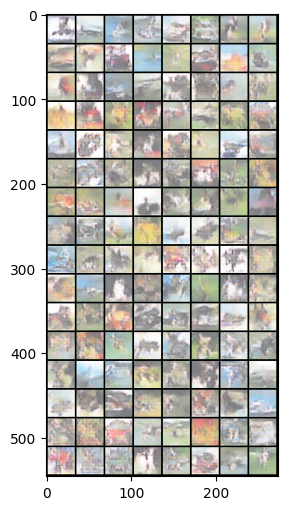

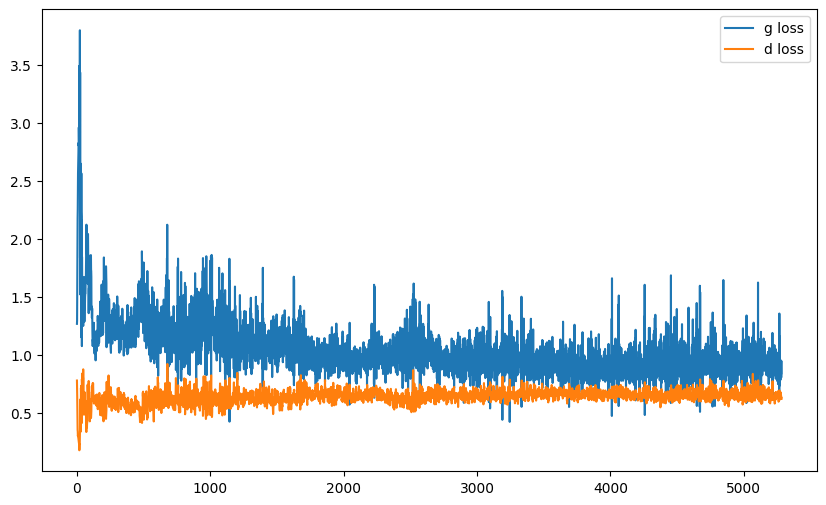

it: 5473; g_loss: 0.7604774236679077; d_loss: 0.657164454460144; avg_real_score: 0.4310160279273987; avg_fake_score: 0.3584994971752167: : 391it [00:33, 11.61it/s]   
it: 5474; g_loss: 1.1806650161743164; d_loss: 0.6349864602088928; avg_real_score: 0.663785994052887; avg_fake_score: 0.5661121606826782: : 0it [00:00, ?it/s]

generated images


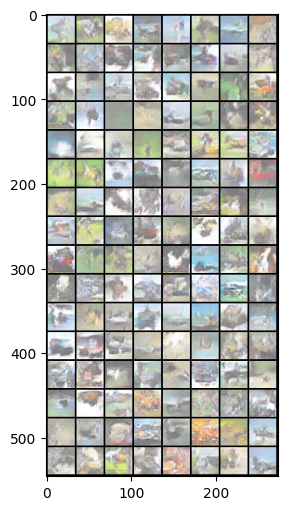

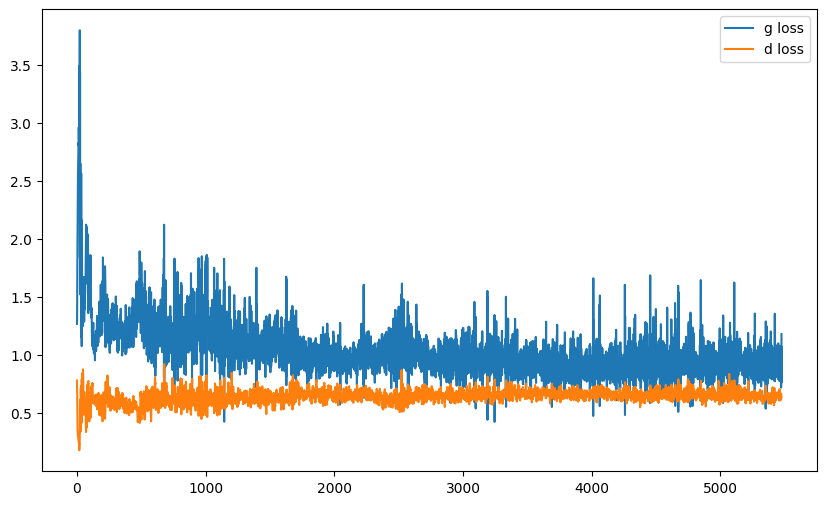

it: 5674; g_loss: 1.0272903442382812; d_loss: 0.6148849725723267; avg_real_score: 0.5779023766517639; avg_fake_score: 0.475774347782135: : 199it [00:16, 12.06it/s]  

generated images


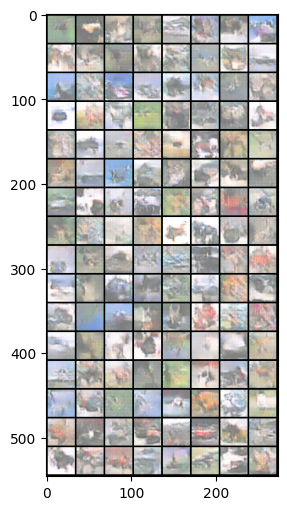

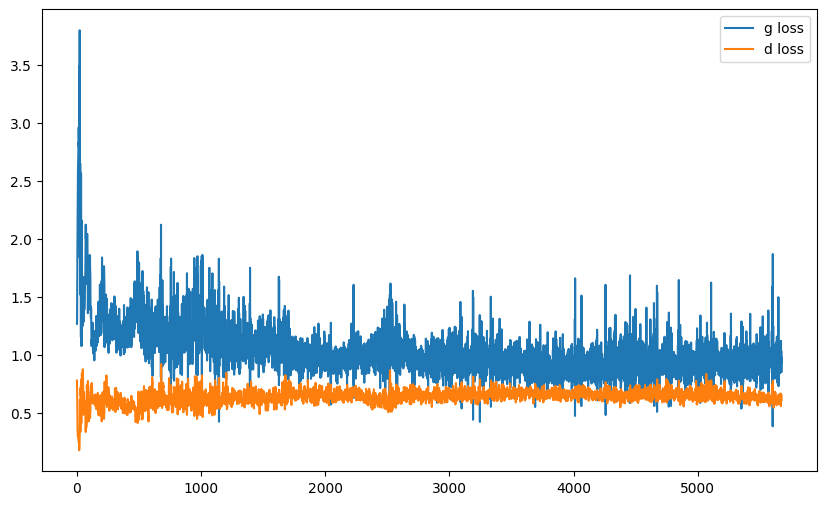

it: 5864; g_loss: 0.9123306274414062; d_loss: 0.6322922706604004; avg_real_score: 0.5932473540306091; avg_fake_score: 0.5097947120666504: : 391it [00:32, 11.96it/s]   
it: 5865; g_loss: 1.1044731140136719; d_loss: 0.5859376192092896; avg_real_score: 0.610120952129364; avg_fake_score: 0.4761958122253418: : 0it [00:00, ?it/s]

generated images


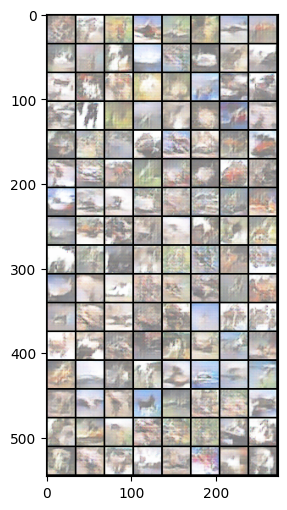

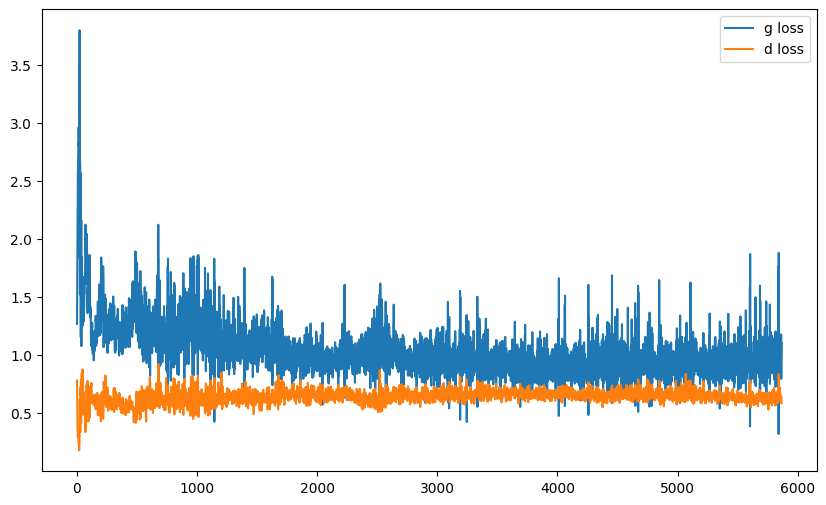

it: 6065; g_loss: 0.8577197790145874; d_loss: 0.6500279307365417; avg_real_score: 0.4920165538787842; avg_fake_score: 0.4253603219985962: : 199it [00:17, 10.30it/s]  

generated images


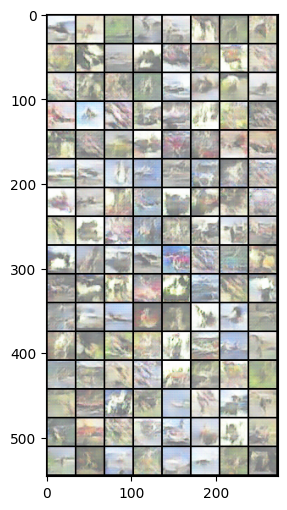

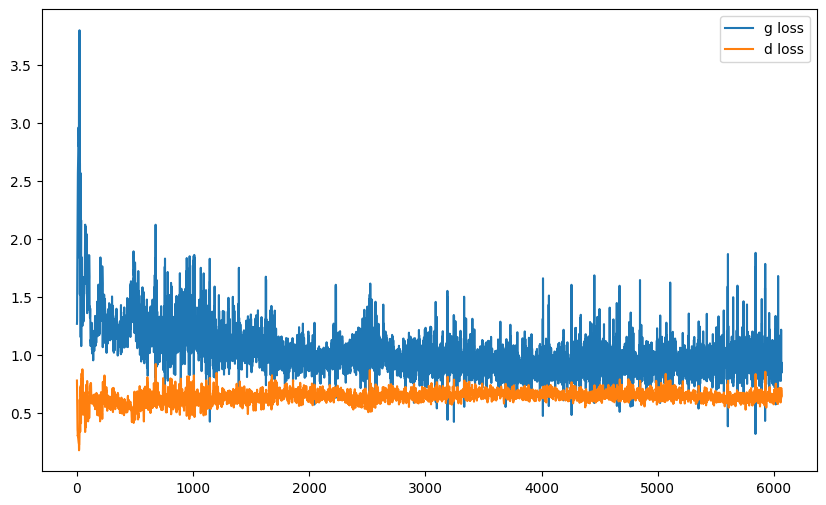

it: 6255; g_loss: 0.9633863568305969; d_loss: 0.728412926197052; avg_real_score: 0.541560173034668; avg_fake_score: 0.5523921251296997: : 391it [00:33, 11.61it/s]     
it: 6256; g_loss: 0.8457132577896118; d_loss: 0.674675464630127; avg_real_score: 0.46726328134536743; avg_fake_score: 0.4225623309612274: : 0it [00:00, ?it/s]

generated images


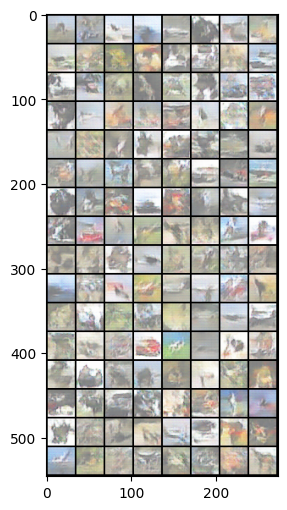

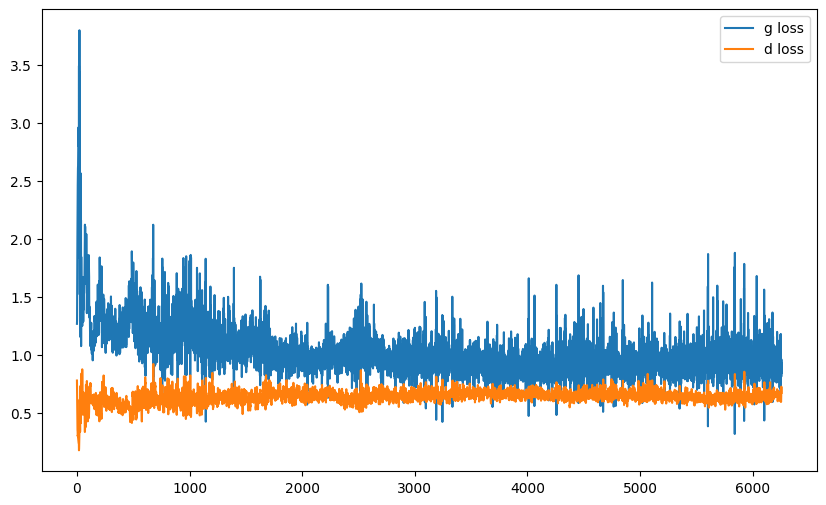

it: 6456; g_loss: 1.1394014358520508; d_loss: 0.6305920481681824; avg_real_score: 0.542850136756897; avg_fake_score: 0.45991864800453186: : 199it [00:17, 12.28it/s]  

generated images


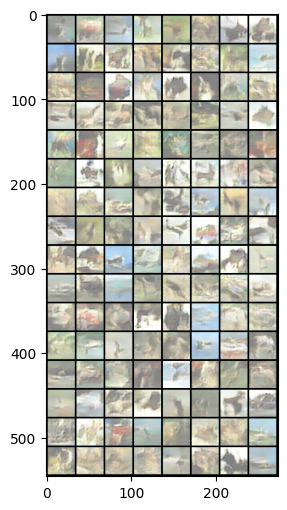

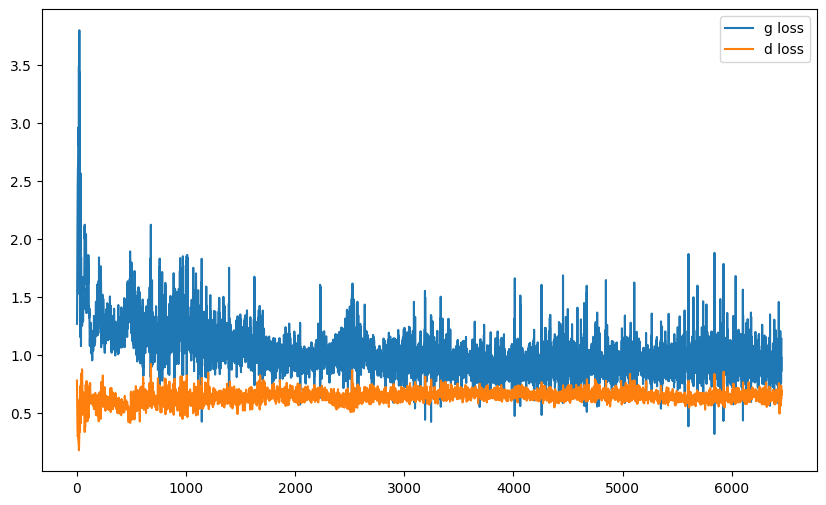

it: 6646; g_loss: 0.9118553400039673; d_loss: 0.6933775544166565; avg_real_score: 0.49563732743263245; avg_fake_score: 0.475643128156662: : 391it [00:33, 11.66it/s]  
it: 6647; g_loss: 0.8315333127975464; d_loss: 0.6838704943656921; avg_real_score: 0.5007879734039307; avg_fake_score: 0.4688289165496826: : 0it [00:00, ?it/s]

generated images


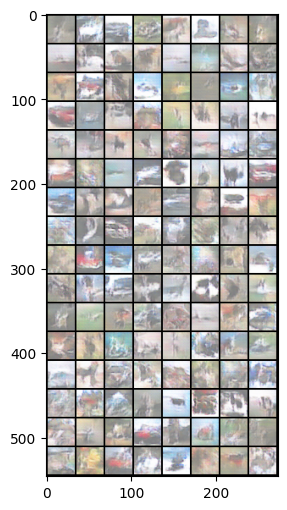

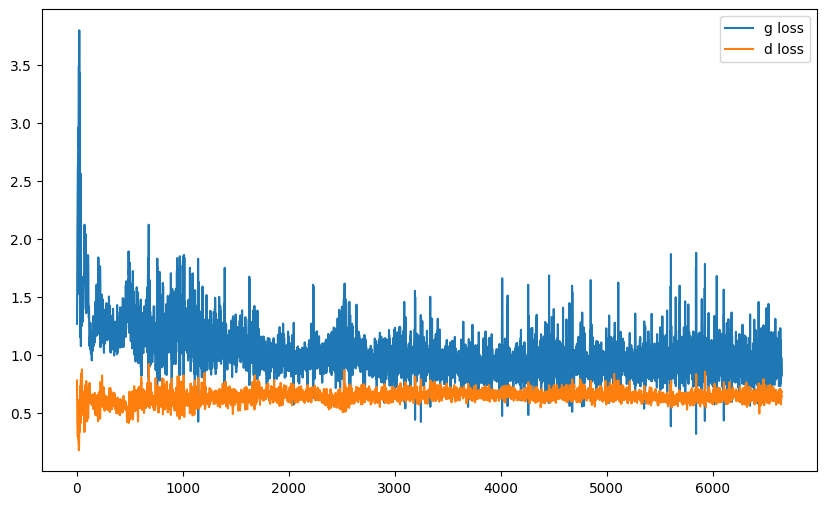

it: 6847; g_loss: 1.0157262086868286; d_loss: 0.6132463216781616; avg_real_score: 0.5232093334197998; avg_fake_score: 0.41638246178627014: : 200it [00:17, 11.21it/s] 

generated images


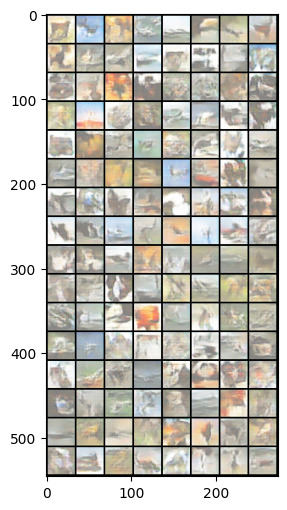

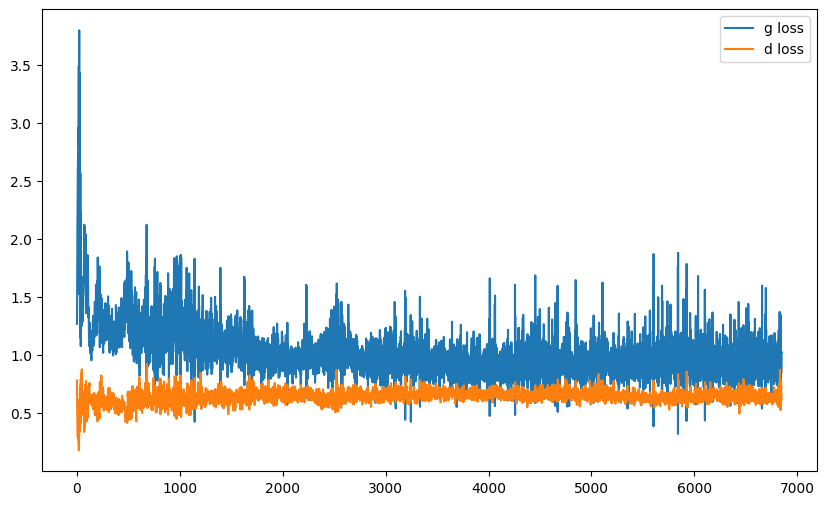

it: 7037; g_loss: 1.0943548679351807; d_loss: 0.6553425788879395; avg_real_score: 0.6144052147865295; avg_fake_score: 0.5469026565551758: : 391it [00:33, 11.64it/s]  
it: 7038; g_loss: 0.9080588221549988; d_loss: 0.6703566908836365; avg_real_score: 0.4876590073108673; avg_fake_score: 0.43986397981643677: : 0it [00:00, ?it/s]

generated images


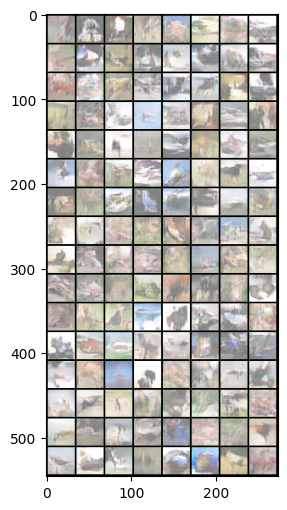

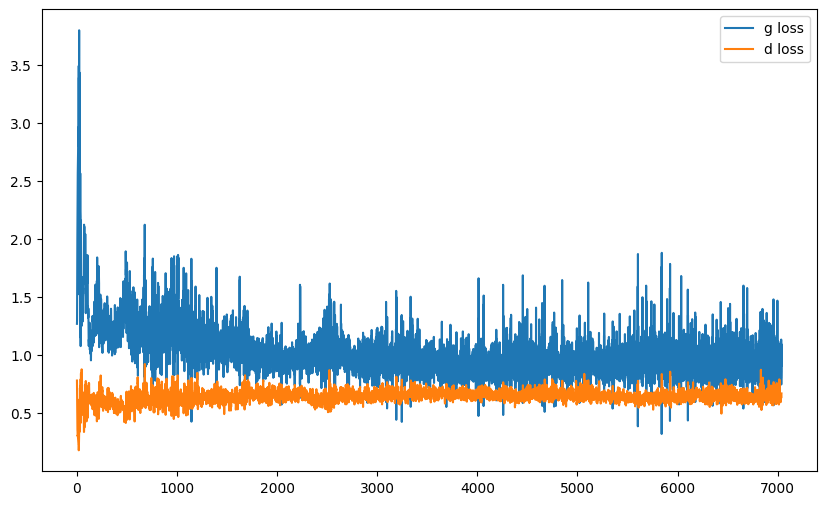

it: 7238; g_loss: 0.7906794548034668; d_loss: 0.6721270084381104; avg_real_score: 0.4843505620956421; avg_fake_score: 0.43238338828086853: : 199it [00:17, 11.54it/s] 

generated images


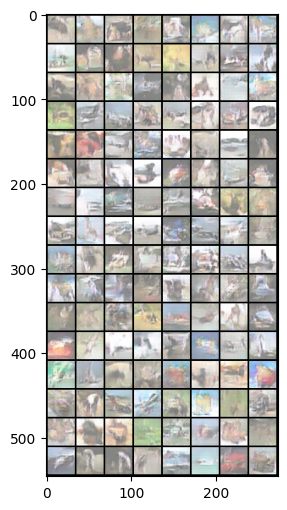

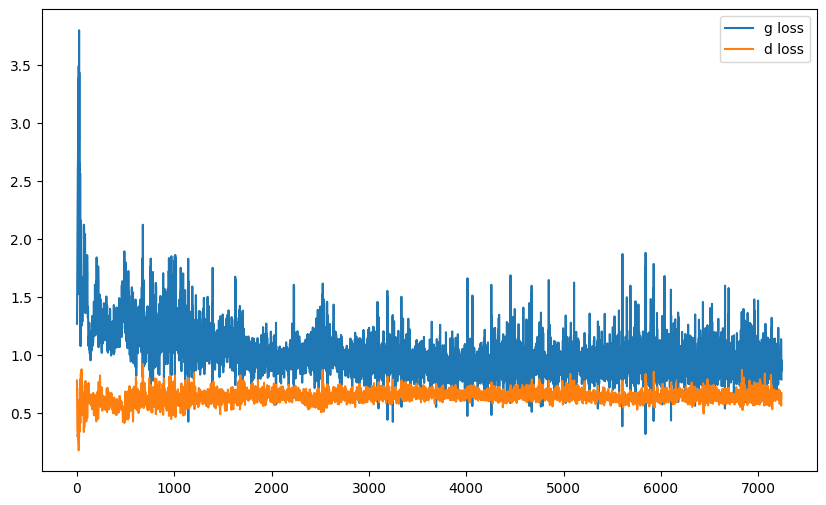

it: 7428; g_loss: 0.8073728680610657; d_loss: 0.6472687125205994; avg_real_score: 0.5142277479171753; avg_fake_score: 0.44902363419532776: : 391it [00:33, 11.53it/s] 
it: 7429; g_loss: 0.8945043683052063; d_loss: 0.6225305199623108; avg_real_score: 0.588415801525116; avg_fake_score: 0.49413251876831055: : 0it [00:00, ?it/s]

generated images


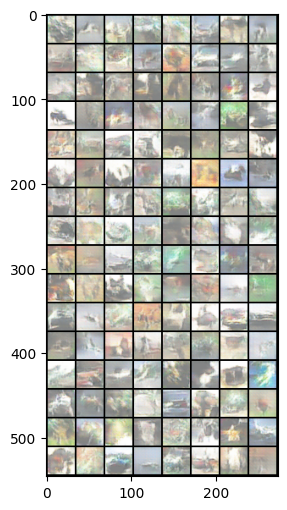

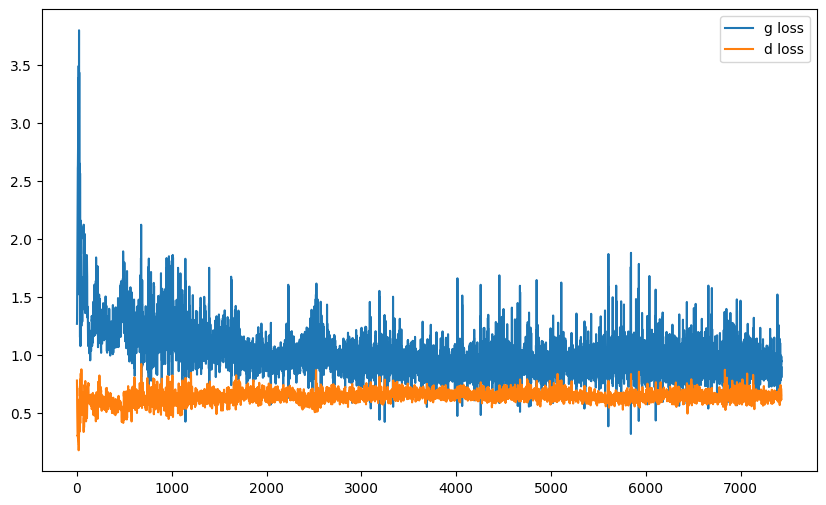

it: 7629; g_loss: 0.8068302869796753; d_loss: 0.6648837327957153; avg_real_score: 0.5020256042480469; avg_fake_score: 0.4580955505371094: : 199it [00:17, 11.78it/s]  

generated images


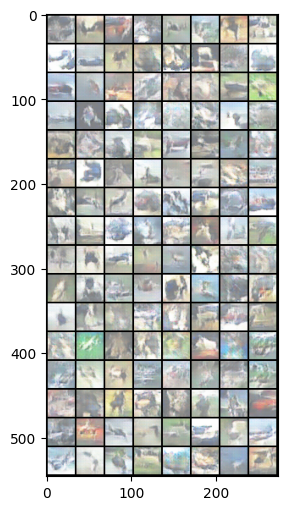

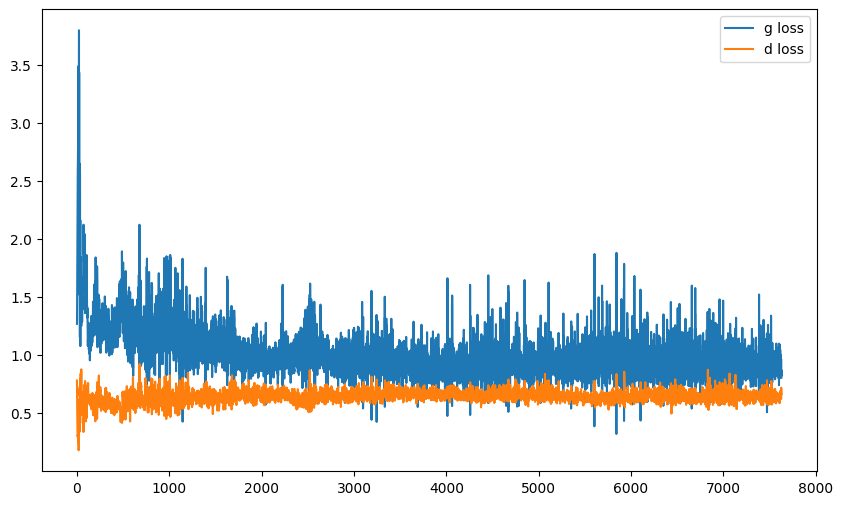

it: 7819; g_loss: 1.0409716367721558; d_loss: 0.655200719833374; avg_real_score: 0.5451093912124634; avg_fake_score: 0.4831208288669586: : 391it [00:33, 11.74it/s]   


In [19]:
g_losses = []
d_losses = []
torch.autograd.set_detect_anomaly(True)

j = 0

z_test = sample_z(64, nz)  # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(cifar_dataloader))
    for i, batch in pbar:
        im, _ = batch  # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]
        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im)

        real_loss = criterion(yhat_real, get_labels_one(cur_batch_size))
        fake_loss = criterion(yhat_fake, get_labels_zero(cur_batch_size))

        ###
        ### Discriminator
        ###

        d_loss = (real_loss + fake_loss) / 2
        d_opt.zero_grad()
        d_loss.backward(
            retain_graph=True)  # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        ###
        ### Generator
        ###

        g_loss = criterion(netD(fake_im), get_labels_one(cur_batch_size))  #      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()

        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(
            f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:
            #fake_im = G(z_test)

            un_norm = renorm(fake_im)  # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

# 4. Conditional GANs [BONUS]

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [85]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()

        self.upscaling_z = nn.Sequential(*get_upscaling_block(nz, ngf*8, 4, 1, 0))
        self.upscaling_c = nn.Sequential(*get_upscaling_block(nc, ngf*8, 4, 1, 0))

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        self.rest_model = nn.Sequential(
            *get_upscaling_block(ngf * 16, ngf * 8, 4, 2, 1),
            *get_upscaling_block(ngf * 8, ngf * 4, 4, 2, 1),
            *get_upscaling_block(ngf * 4, 1, 4, 2, 1, last_layer=True),
        )

        ###################

    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        y = y.unsqueeze(2).unsqueeze(2)

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        x = self.upscaling_z(x)
        y = self.upscaling_c(y)
        
        x = torch.cat([x, y], dim=1)

        return self.rest_model(x)

### 4.1.2 Discriminator

In [86]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.downscale_x = nn.Sequential(*get_downscaling_block(nchannels, ndf*2, 4, 2, 1, use_batch_norm=False))
        self.downscale_y = nn.Sequential(*get_downscaling_block(nc, ndf*2, 4, 2, 1, use_batch_norm=False))
        self.y_projection = nn.Linear(10, 32 * 32 * 10)

        ###################
        #                 #
        # YOUR CODE HERE  #

        self.rest = nn.Sequential(
            *get_downscaling_block(ndf * 4, ndf * 8, 4, 2, 1, use_batch_norm=True),
            *get_downscaling_block(ndf * 8, ndf * 16, 4, 2, 1, use_batch_norm=True),
            *get_downscaling_block(ndf * 16, 1, 4, 1, 0, use_batch_norm=False, is_last=True),
        )

        #                 #
        ###################

    def forward(self, x, y):
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        x = self.downscale_x(x)
        y = self.downscale_y(self.y_projection(y).reshape(y.shape[0], 10, 32, 32))
        
        x = torch.cat([x, y], dim=1)

        return self.rest(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 4.1.3 Sanity Checks

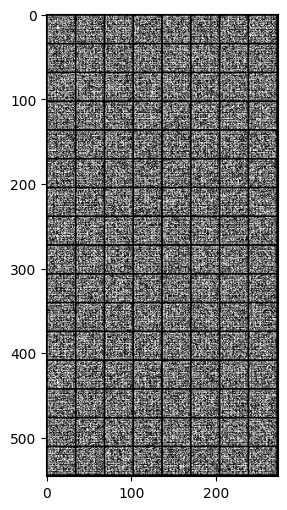

In [87]:
# CONDITIONAL GENERATOR SANITY CHECKING

z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

In [88]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

## 4.2 Training

In [89]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))



it: 0; g_loss: 2.5883736610412598; d_loss: 1.0460641384124756; avg_real_score: 0.36074572801589966; avg_fake_score: 0.5482136011123657: : 0it [00:00, ?it/s]

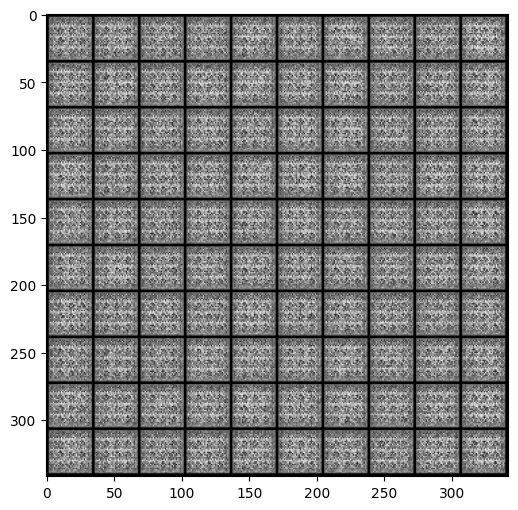

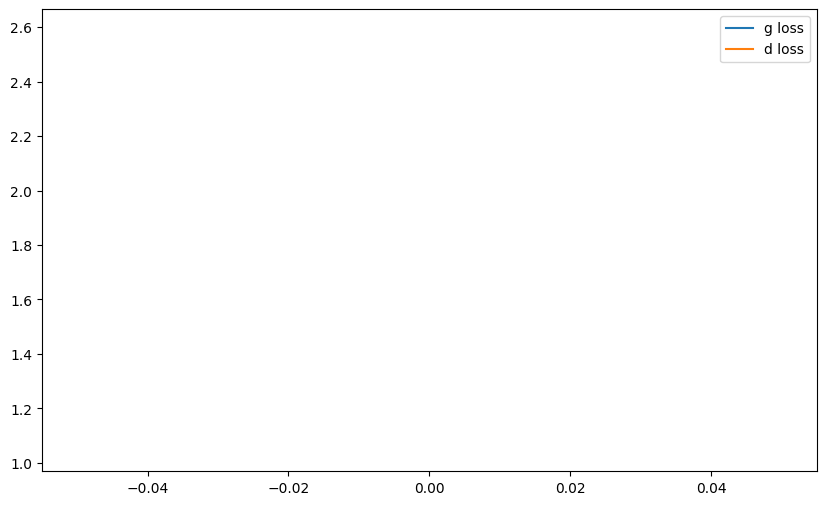

it: 200; g_loss: 3.64927339553833; d_loss: 0.8177654147148132; avg_real_score: 0.7806983590126038; avg_fake_score: 0.7157772183418274: : 200it [00:35,  4.88it/s]    

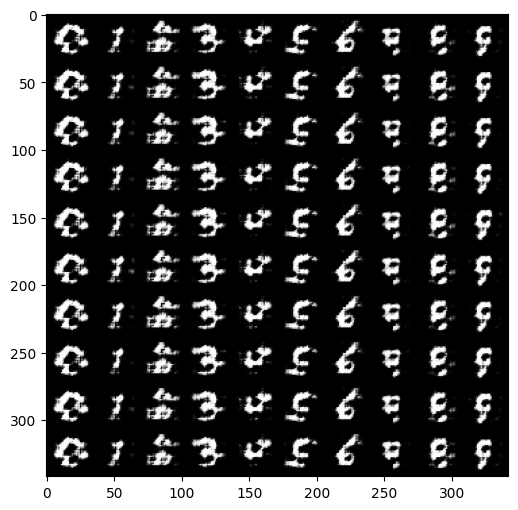

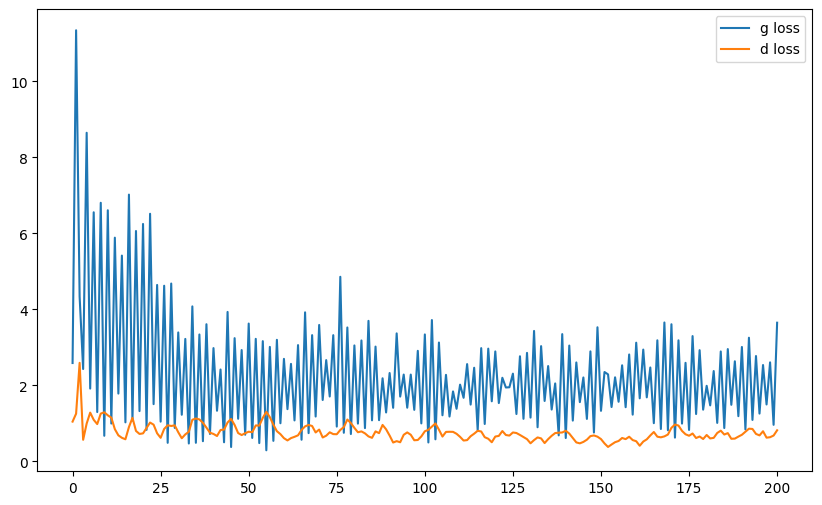

it: 400; g_loss: 2.255831718444824; d_loss: 0.3771257996559143; avg_real_score: 0.7066992521286011; avg_fake_score: 0.2766895294189453: : 400it [01:11,  8.40it/s]   

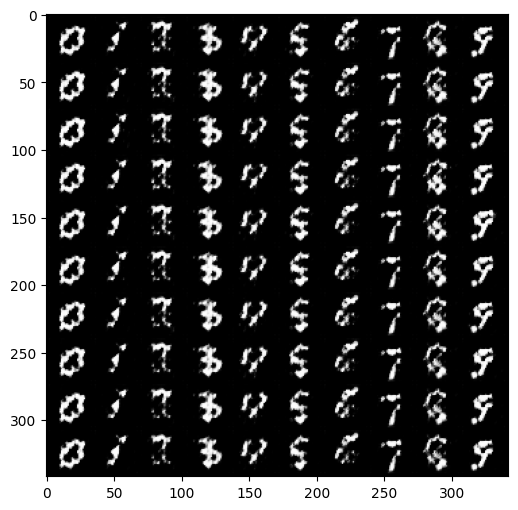

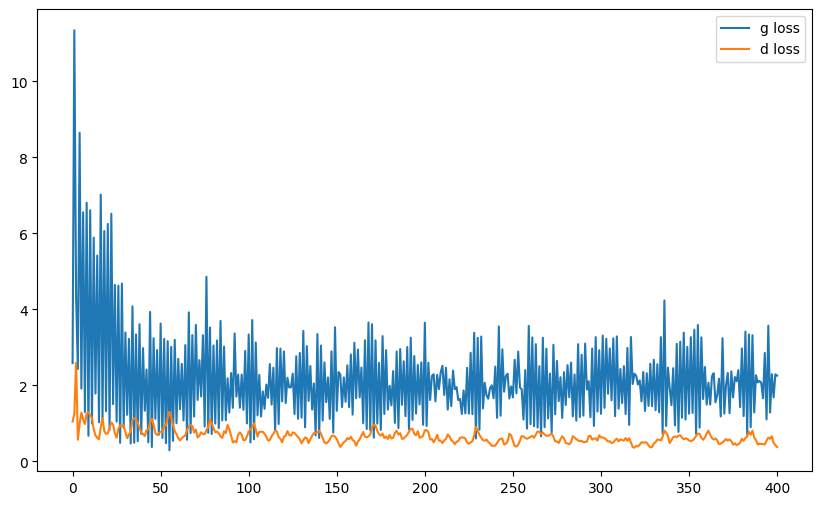

it: 468; g_loss: 2.738436460494995; d_loss: 0.6265404224395752; avg_real_score: 0.6729269027709961; avg_fake_score: 0.5295050144195557: : 469it [01:26,  5.42it/s]   
it: 469; g_loss: 0.8474627733230591; d_loss: 0.6164612770080566; avg_real_score: 0.4501710832118988; avg_fake_score: 0.1982376128435135: : 0it [00:00, ?it/s]

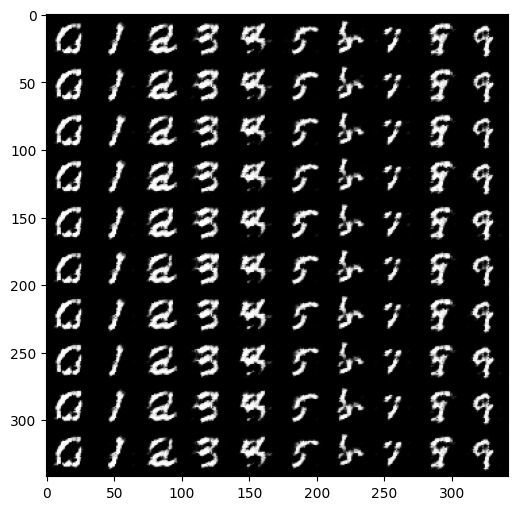

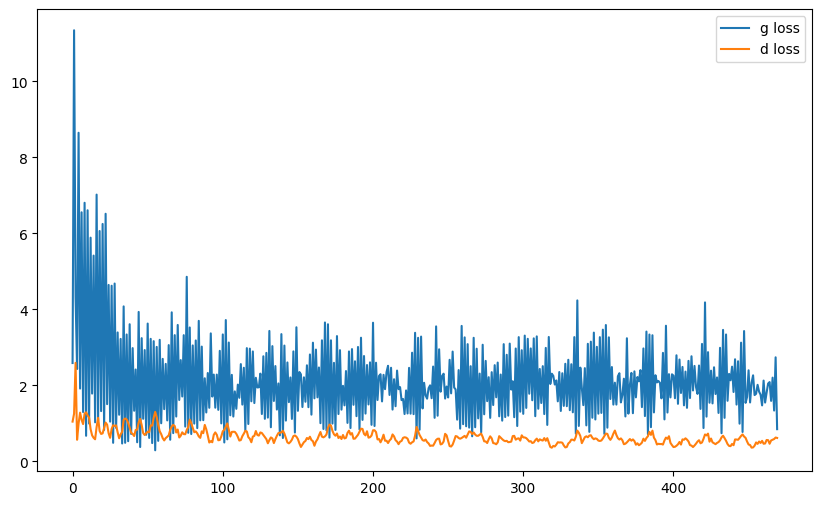

it: 669; g_loss: 3.23625111579895; d_loss: 0.5184577107429504; avg_real_score: 0.7897912859916687; avg_fake_score: 0.5227406620979309: : 200it [00:43,  4.58it/s]    

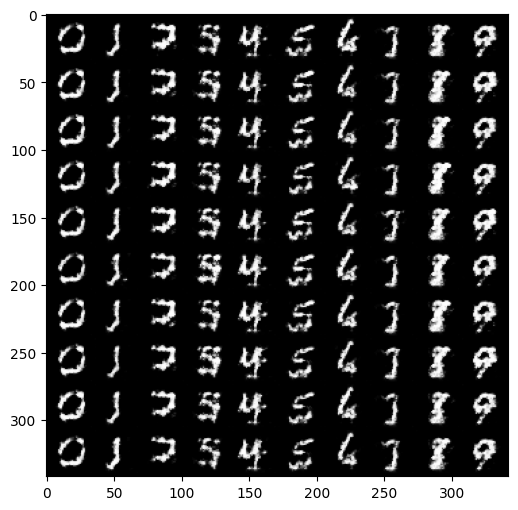

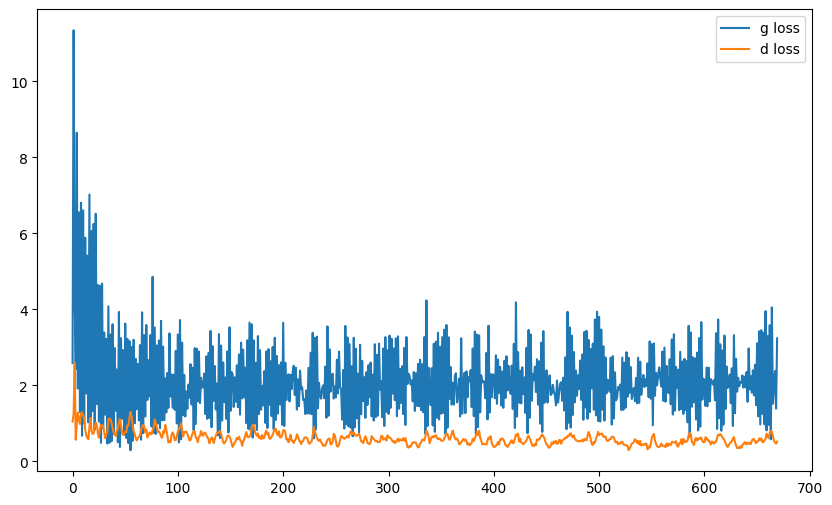

it: 869; g_loss: 1.4627790451049805; d_loss: 0.49099335074424744; avg_real_score: 0.5958644151687622; avg_fake_score: 0.24832862615585327: : 400it [01:26,  4.85it/s]

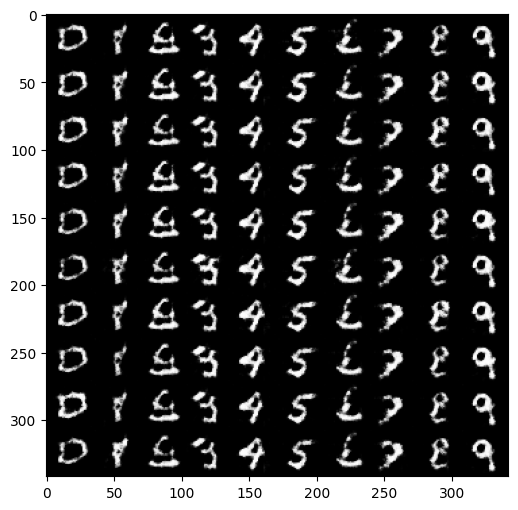

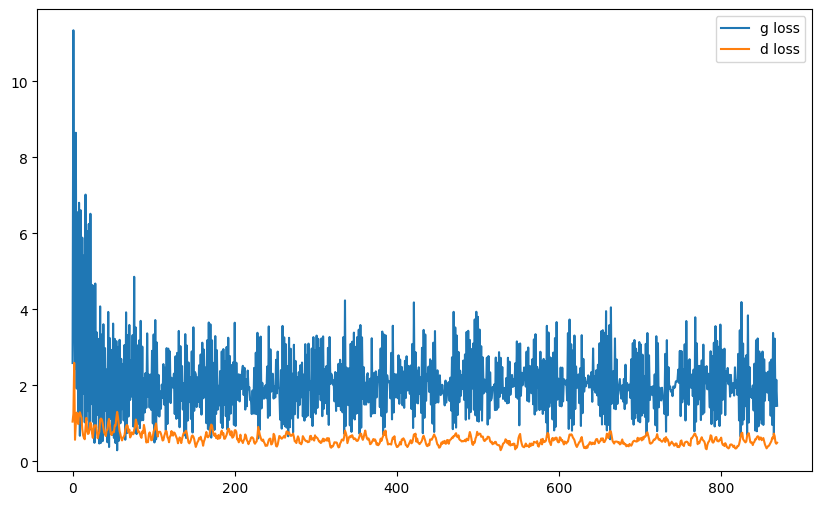

it: 937; g_loss: 3.3315482139587402; d_loss: 0.6598865389823914; avg_real_score: 0.8361693620681763; avg_fake_score: 0.652289628982544: : 469it [01:43,  4.51it/s]   
it: 938; g_loss: 1.224153995513916; d_loss: 0.6194257140159607; avg_real_score: 0.4414125084877014; avg_fake_score: 0.12232867628335953: : 0it [00:00, ?it/s]

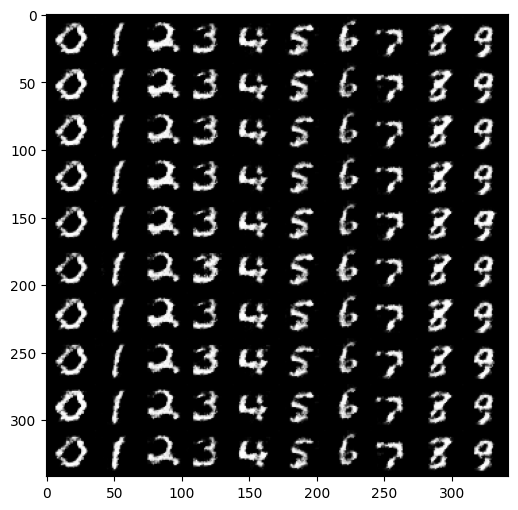

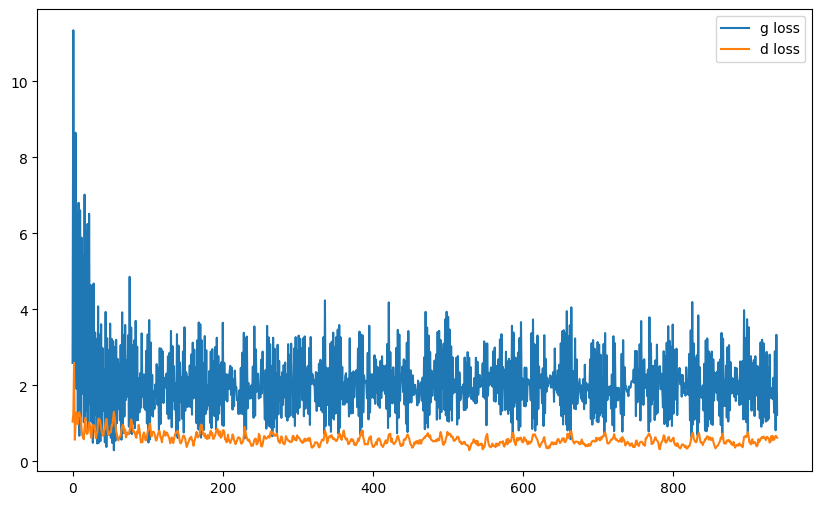

it: 1138; g_loss: 3.155606985092163; d_loss: 0.7273954749107361; avg_real_score: 0.8698706030845642; avg_fake_score: 0.6991198658943176: : 200it [00:35,  6.92it/s]   

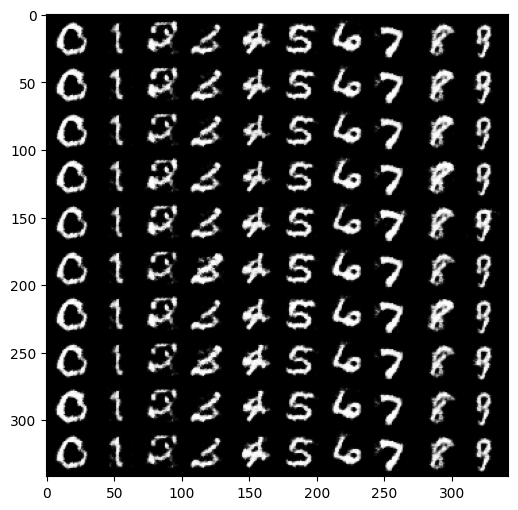

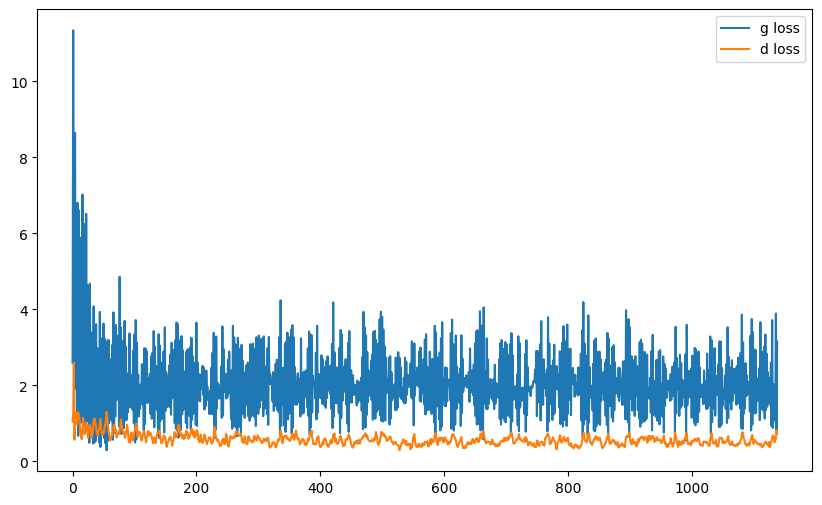

it: 1338; g_loss: 2.0189270973205566; d_loss: 0.4006913900375366; avg_real_score: 0.6957885026931763; avg_fake_score: 0.2996688187122345: : 400it [01:05,  5.90it/s]  

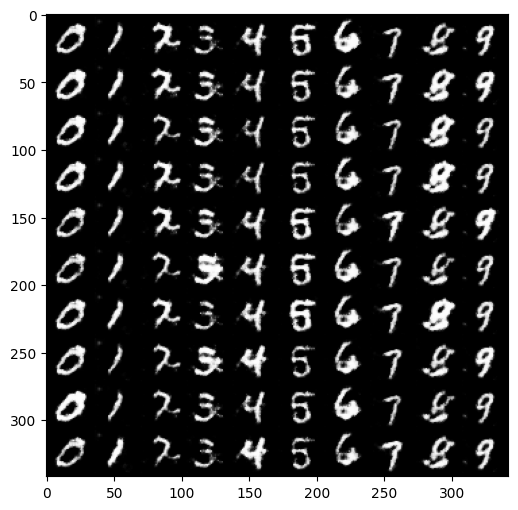

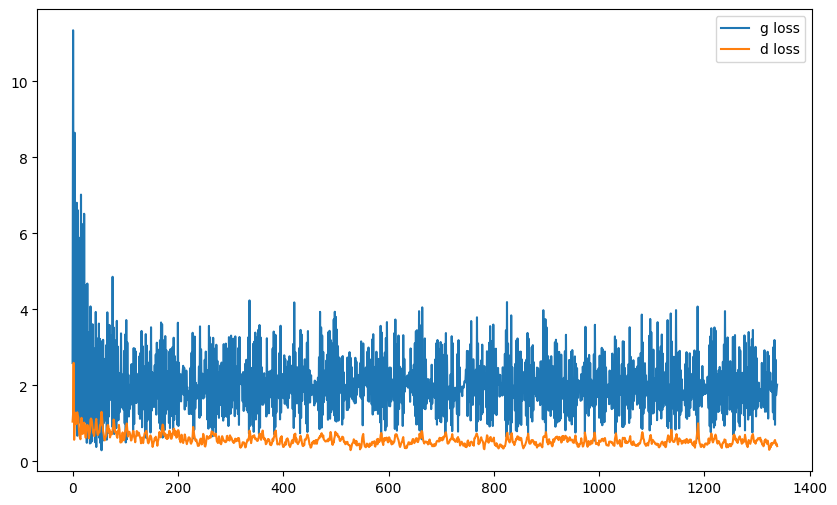

it: 1406; g_loss: 3.153177261352539; d_loss: 0.487729549407959; avg_real_score: 0.8216140270233154; avg_fake_score: 0.5134702920913696: : 469it [01:16,  6.10it/s]    
it: 1407; g_loss: 1.1674463748931885; d_loss: 0.5131298899650574; avg_real_score: 0.5029253959655762; avg_fake_score: 0.1317070722579956: : 0it [00:00, ?it/s]

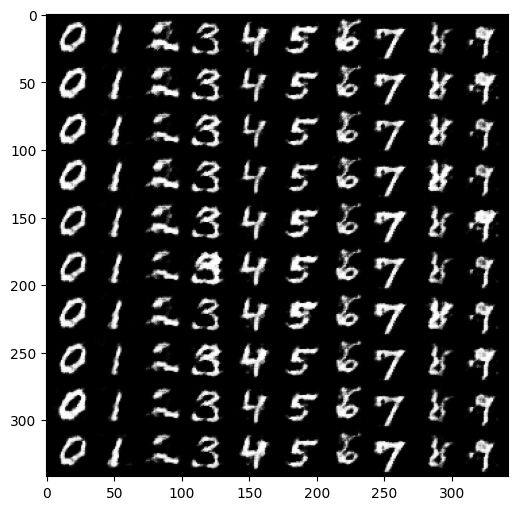

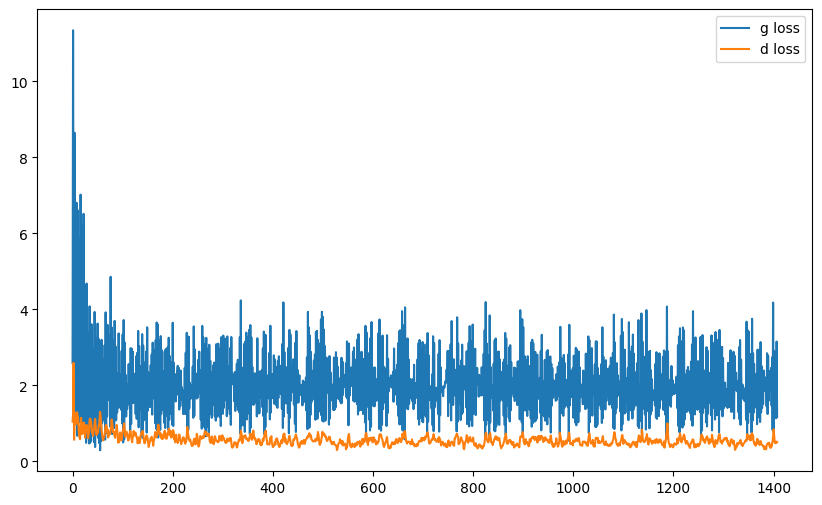

it: 1607; g_loss: 0.905073881149292; d_loss: 0.4899119436740875; avg_real_score: 0.5214904546737671; avg_fake_score: 0.13547305762767792: : 200it [00:28,  7.03it/s]  

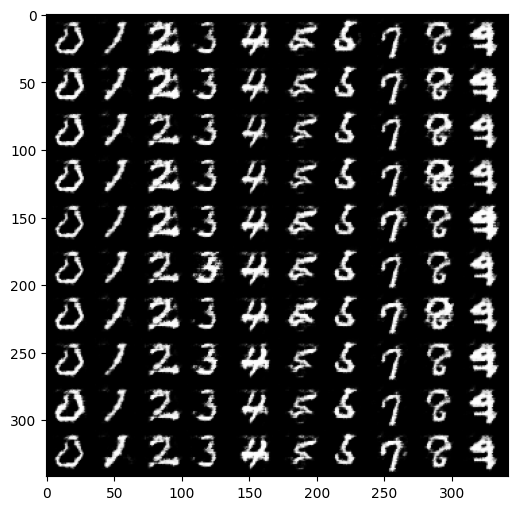

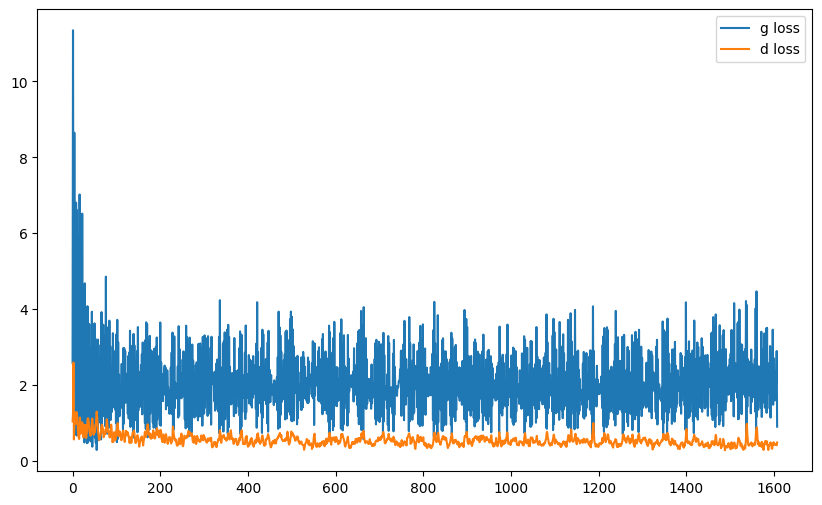

it: 1807; g_loss: 2.0770492553710938; d_loss: 0.4321952164173126; avg_real_score: 0.7401680946350098; avg_fake_score: 0.35290905833244324: : 400it [01:00,  4.63it/s]  

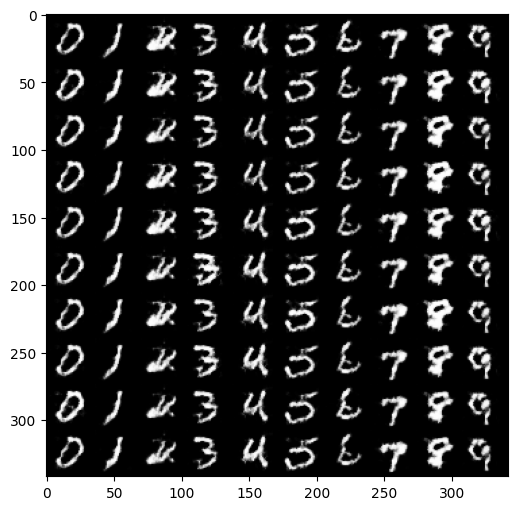

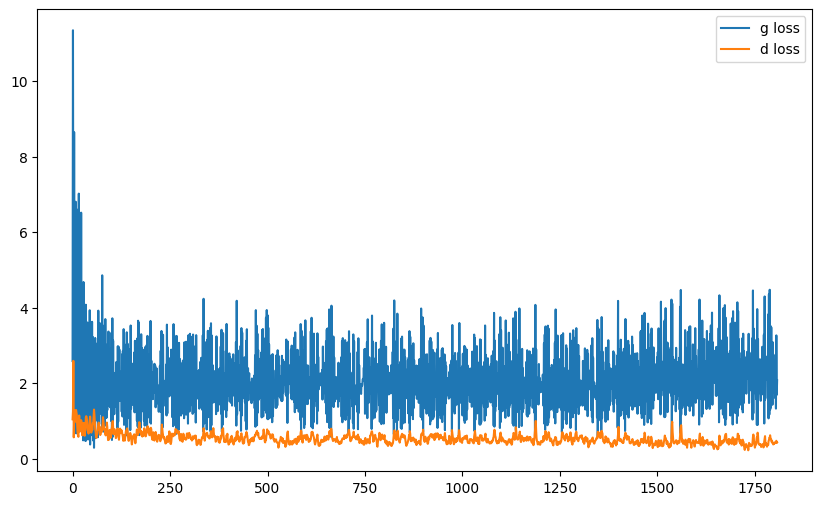

it: 1875; g_loss: 2.953468084335327; d_loss: 0.3060940206050873; avg_real_score: 0.8656238317489624; avg_fake_score: 0.33516085147857666: : 469it [01:13,  6.37it/s]   
it: 1876; g_loss: 2.0667099952697754; d_loss: 0.26922091841697693; avg_real_score: 0.7309688329696655; avg_fake_score: 0.123710036277771: : 0it [00:00, ?it/s]

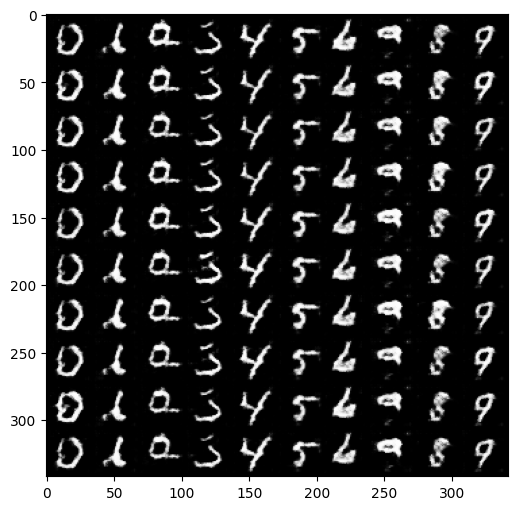

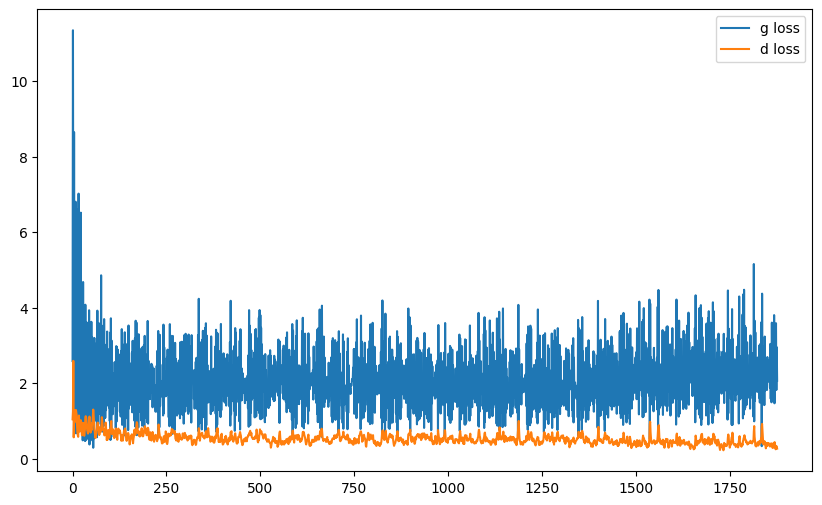

it: 2076; g_loss: 1.5950489044189453; d_loss: 0.3893948793411255; avg_real_score: 0.5972567796707153; avg_fake_score: 0.10419359058141708: : 200it [00:28,  5.88it/s] 

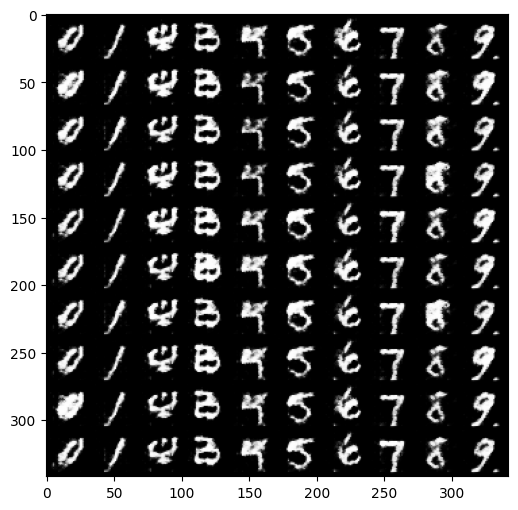

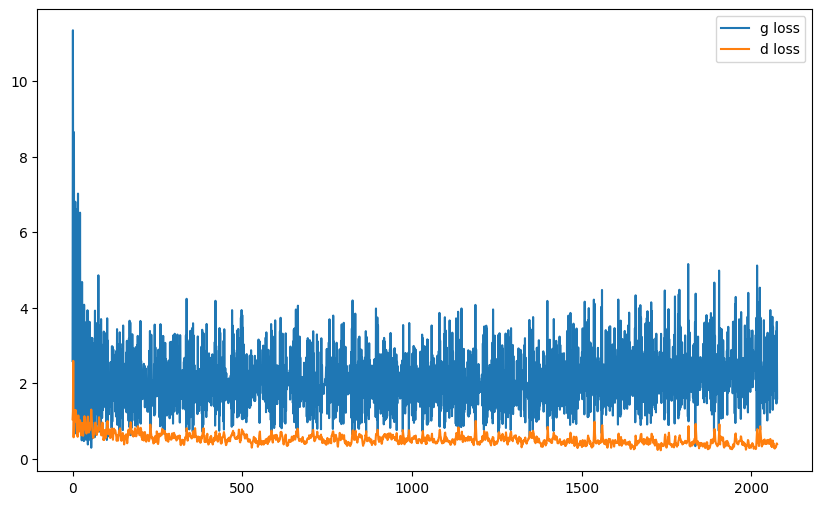

it: 2276; g_loss: 3.69377064704895; d_loss: 0.4374159872531891; avg_real_score: 0.853201687335968; avg_fake_score: 0.4775865972042084: : 400it [00:56,  7.73it/s]      

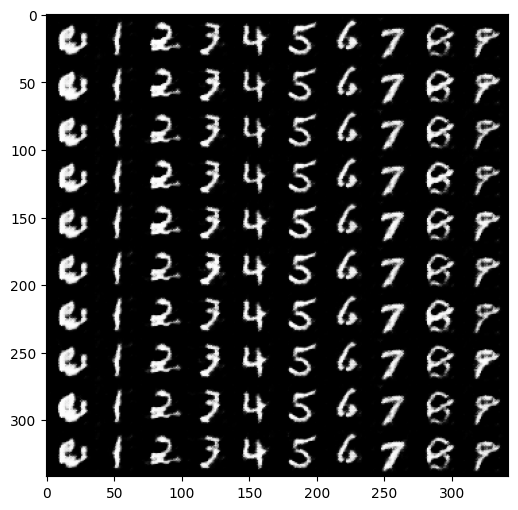

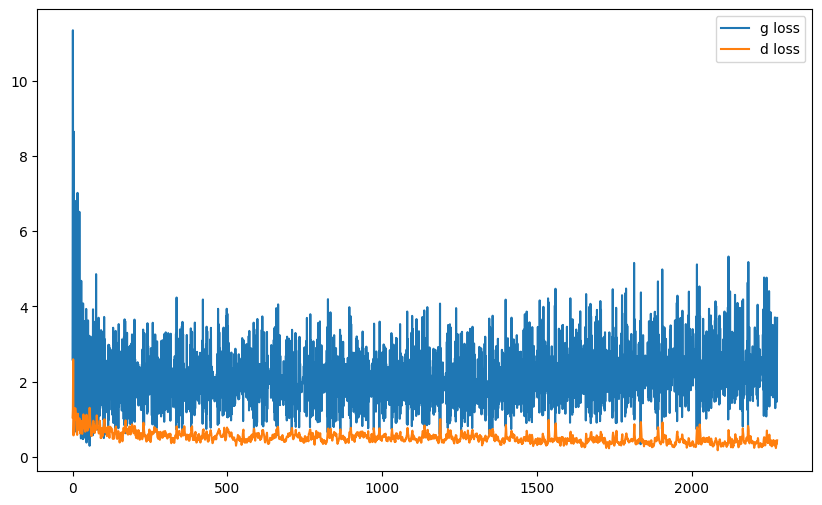

it: 2344; g_loss: 2.900263547897339; d_loss: 0.3080053925514221; avg_real_score: 0.8258947134017944; avg_fake_score: 0.27940768003463745: : 469it [01:05,  7.13it/s]  


In [90]:
nb_epochs = 5

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing


for epoch in range(nb_epochs):

    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch
        im = im.to(device)


        y = F.one_hot(labels).float().to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z, y)


        # 3. Classify real image with D
        yhat_real = netD(im, y)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im, y)
        
        real_loss = criterion(yhat_real, get_labels_one(cur_batch_size))
        fake_loss = criterion(yhat_fake, get_labels_zero(cur_batch_size))
        
        ###
        ### Discriminator
        ###

        d_loss = (real_loss + fake_loss) / 2
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        ###
        ### Generator
        ###


        g_loss = criterion(netD(fake_im, y), get_labels_one(cur_batch_size))
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")

        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)

            plt.imshow(pil_grid)
            plt.show()


            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1


## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

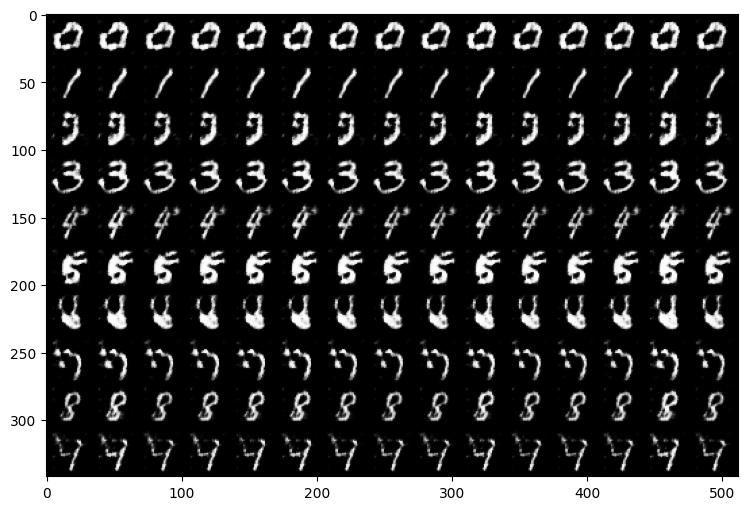

In [91]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

ys = F.one_hot(labels).float()
fake_ims = netG(z, ys)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()
